# Rain in Australia Data Set

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.lines as mlines
import seaborn as sns
import missingno as msno
from math import floor
from sklearn.model_selection import train_test_split
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
import scipy.stats as stats
from sklearn.metrics import precision_score, recall_score, f1_score
from sklearn.metrics import roc_auc_score, roc_curve, confusion_matrix, classification_report
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC, LinearSVC
from sklearn.calibration import CalibratedClassifierCV
from imblearn.over_sampling import SMOTE
import warnings

In [2]:
warnings.simplefilter(action="ignore", category=FutureWarning)
warnings.simplefilter(action="ignore", category=UserWarning)

In [3]:
df = pd.read_csv("data/weatherAUS.csv")

# EDA and Basic Engineering

## Data Inspection

In [4]:
df.T

,0,1,2,3,4,5,6,7,8,9,...,145450,145451,145452,145453,145454,145455,145456,145457,145458,145459
Date,2008-12-01,2008-12-02,2008-12-03,2008-12-04,2008-12-05,2008-12-06,2008-12-07,2008-12-08,2008-12-09,2008-12-10,...,2017-06-16,2017-06-17,2017-06-18,2017-06-19,2017-06-20,2017-06-21,2017-06-22,2017-06-23,2017-06-24,2017-06-25
Location,Albury,Albury,Albury,Albury,Albury,Albury,Albury,Albury,Albury,Albury,...,Uluru,Uluru,Uluru,Uluru,Uluru,Uluru,Uluru,Uluru,Uluru,Uluru
MinTemp,13.4,7.4,12.9,9.2,17.5,14.6,14.3,7.7,9.7,13.1,...,5.2,6.4,8.0,7.4,3.5,2.8,3.6,5.4,7.8,14.9
MaxTemp,22.9,25.1,25.7,28.0,32.3,29.7,25.0,26.7,31.9,30.1,...,24.3,23.4,20.7,20.6,21.8,23.4,25.3,26.9,27.0,NaN
Rainfall,0.6,0.0,0.0,0.0,1.0,0.2,0.0,0.0,0.0,1.4,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Evaporation,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Sunshine,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
WindGustDir,W,WNW,WSW,NE,W,WNW,W,W,NNW,W,...,E,ESE,ESE,E,E,E,NNW,N,SE,NaN
WindGustSpeed,44.0,44.0,46.0,24.0,41.0,56.0,50.0,35.0,80.0,28.0,...,24.0,31.0,41.0,35.0,31.0,31.0,22.0,37.0,28.0,NaN
WindDir9am,W,NNW,W,SE,ENE,W,SW,SSE,SE,S,...,SE,S,SE,ESE,ESE,SE,SE,SE,SSE,ESE


Let's check data types and potential if there are missing values in data set features 

In [5]:
df.dtypes

Date              object
Location          object
MinTemp          float64
MaxTemp          float64
Rainfall         float64
Evaporation      float64
Sunshine         float64
WindGustDir       object
WindGustSpeed    float64
WindDir9am        object
WindDir3pm        object
WindSpeed9am     float64
WindSpeed3pm     float64
Humidity9am      float64
Humidity3pm      float64
Pressure9am      float64
Pressure3pm      float64
Cloud9am         float64
Cloud3pm         float64
Temp9am          float64
Temp3pm          float64
RainToday         object
RainTomorrow      object
dtype: object

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 145460 entries, 0 to 145459
Data columns (total 23 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   Date           145460 non-null  object 
 1   Location       145460 non-null  object 
 2   MinTemp        143975 non-null  float64
 3   MaxTemp        144199 non-null  float64
 4   Rainfall       142199 non-null  float64
 5   Evaporation    82670 non-null   float64
 6   Sunshine       75625 non-null   float64
 7   WindGustDir    135134 non-null  object 
 8   WindGustSpeed  135197 non-null  float64
 9   WindDir9am     134894 non-null  object 
 10  WindDir3pm     141232 non-null  object 
 11  WindSpeed9am   143693 non-null  float64
 12  WindSpeed3pm   142398 non-null  float64
 13  Humidity9am    142806 non-null  float64
 14  Humidity3pm    140953 non-null  float64
 15  Pressure9am    130395 non-null  float64
 16  Pressure3pm    130432 non-null  float64
 17  Cloud9am       89572 non-null

### Missing Values

<Axes: >

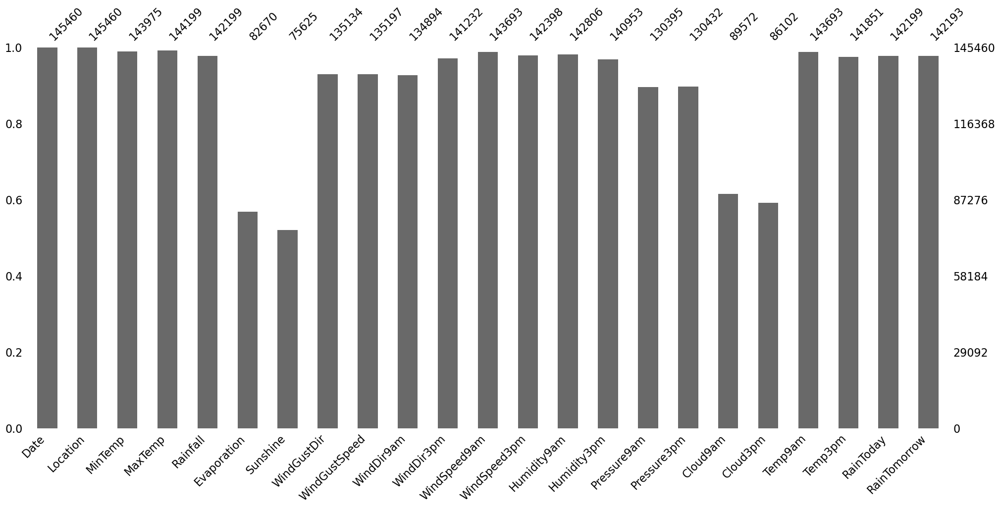

In [7]:
msno.bar(df)

We can observe that there are missing values in 18 features. At this point, it is acceptable to remove rows containing missing values in both our target feature and the 'RainToday' feature.

In [8]:
df = df[df["RainTomorrow"].notna()]
df = df[df["RainToday"].notna()]

In [9]:
df.isna().sum().sort_values(ascending=False)

Sunshine         66805
Evaporation      59694
Cloud3pm         56094
Cloud9am         52625
Pressure3pm      13769
Pressure9am      13743
WindDir9am        9660
WindGustDir       9163
WindGustSpeed     9105
WindDir3pm        3670
Humidity3pm       3501
Temp3pm           2624
WindSpeed3pm      2531
Humidity9am       1517
WindSpeed9am      1055
Temp9am            656
MinTemp            468
MaxTemp            307
RainToday            0
Date                 0
Location             0
Rainfall             0
RainTomorrow         0
dtype: int64

### Check Duplicate Rows

In [10]:
df.duplicated().sum()

0

### Replace Yes and No to 1 and 0 in Categorical Features

We can convert Yes to 1 and No to 0 in some of the Categorical Features:

In [11]:
df['RainToday'].replace({"No": 0, "Yes": 1}, inplace = True)
df['RainTomorrow'].replace({"No": 0, "Yes": 1}, inplace = True)

### Change Date to Datetime type

Let's use the datetime data type for the 'Date' feature instead of the string data type:

In [12]:
df["Date"]

0         2008-12-01
1         2008-12-02
2         2008-12-03
3         2008-12-04
4         2008-12-05
             ...    
145454    2017-06-20
145455    2017-06-21
145456    2017-06-22
145457    2017-06-23
145458    2017-06-24
Name: Date, Length: 140787, dtype: object

In [13]:
df["Date"] = pd.to_datetime(df["Date"], format="%Y-%m-%d")

In [14]:
df["Date"]

0        2008-12-01
1        2008-12-02
2        2008-12-03
3        2008-12-04
4        2008-12-05
            ...    
145454   2017-06-20
145455   2017-06-21
145456   2017-06-22
145457   2017-06-23
145458   2017-06-24
Name: Date, Length: 140787, dtype: datetime64[ns]

### Feature Names Division

In [15]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 140787 entries, 0 to 145458
Data columns (total 23 columns):
 #   Column         Non-Null Count   Dtype         
---  ------         --------------   -----         
 0   Date           140787 non-null  datetime64[ns]
 1   Location       140787 non-null  object        
 2   MinTemp        140319 non-null  float64       
 3   MaxTemp        140480 non-null  float64       
 4   Rainfall       140787 non-null  float64       
 5   Evaporation    81093 non-null   float64       
 6   Sunshine       73982 non-null   float64       
 7   WindGustDir    131624 non-null  object        
 8   WindGustSpeed  131682 non-null  float64       
 9   WindDir9am     131127 non-null  object        
 10  WindDir3pm     137117 non-null  object        
 11  WindSpeed9am   139732 non-null  float64       
 12  WindSpeed3pm   138256 non-null  float64       
 13  Humidity9am    139270 non-null  float64       
 14  Humidity3pm    137286 non-null  float64       
 15  Press

Let's categorize features into numerical, categorical, and target:

In [16]:
target = "RainTomorrow"
target_feature = [target]
categorical_features = ["Date", "Location", "WindGustDir", "WindDir9am", "WindDir3pm", "RainToday"]
numerical_features = [col for col in df.columns if col not in (categorical_features + target_feature)]

In [17]:
numerical_features

['MinTemp',
 'MaxTemp',
 'Rainfall',
 'Evaporation',
 'Sunshine',
 'WindGustSpeed',
 'WindSpeed9am',
 'WindSpeed3pm',
 'Humidity9am',
 'Humidity3pm',
 'Pressure9am',
 'Pressure3pm',
 'Cloud9am',
 'Cloud3pm',
 'Temp9am',
 'Temp3pm']

In [18]:
categorical_features

['Date', 'Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday']

In [19]:
target_feature

['RainTomorrow']

## Descriptive Statistics

In [20]:
def get_extended_description(df):
    extended_describe = df.describe().T
    extended_describe["IQR"] = extended_describe["75%"] - extended_describe["25%"]
    extended_describe["lower_limit"] = extended_describe["25%"] - 1.5*extended_describe["IQR"]
    extended_describe["upper_limit"] = extended_describe["75%"] + 1.5*extended_describe["IQR"]
    return extended_describe

In [21]:
extended_describe = get_extended_description(df)
extended_describe

,count,mean,min,25%,50%,75%,max,std,IQR,lower_limit,upper_limit
Date,140787,2013-03-31 12:35:10.183468288,2007-11-01 00:00:00,2011-01-05 00:00:00,2013-05-27 00:00:00,2015-06-13 00:00:00,2017-06-25 00:00:00,NaN,1620 days 00:00:00,2004-05-11 00:00:00,2022-02-06 00:00:00
MinTemp,140319.0,12.184824,-8.5,7.6,12.0,16.8,33.9,6.403879,9.2,-6.2,30.6
MaxTemp,140480.0,23.23512,-4.8,17.9,22.6,28.3,48.1,7.1145,10.4,2.3,43.9
Rainfall,140787.0,2.349974,0.0,0.0,0.0,0.8,371.0,8.465173,0.8,-1.2,2.0
Evaporation,81093.0,5.472516,0.0,2.6,4.8,7.4,145.0,4.189132,4.8,-4.6,14.6
Sunshine,73982.0,7.63054,0.0,4.9,8.5,10.7,14.5,3.781729,5.8,-3.8,19.4
WindGustSpeed,131682.0,39.97052,6.0,31.0,39.0,48.0,135.0,13.578201,17.0,5.5,73.5
WindSpeed9am,139732.0,13.990496,0.0,7.0,13.0,19.0,130.0,8.88621,12.0,-11.0,37.0
WindSpeed3pm,138256.0,18.631141,0.0,13.0,19.0,24.0,87.0,8.798096,11.0,-3.5,40.5
Humidity9am,139270.0,68.826833,0.0,57.0,70.0,83.0,100.0,19.06365,26.0,18.0,122.0


The distribution of data, described by quartiles, appears interesting for some features such as Rainfall, Evaporation, and Winds-Features. In these cases, a significant portion of relatively low values falls within the range from the minimum to the third quartile (Q3).

In [22]:
for feature in categorical_features:
    print(f"----------{feature.upper()}----------")
    print(df[feature].value_counts(), end="\n\n")

----------DATE----------
Date
2013-12-15    49
2016-07-16    49
2014-01-20    49
2016-08-15    49
2016-08-16    49
              ..
2007-11-29     1
2007-11-28     1
2007-11-27     1
2007-11-26     1
2008-01-31     1
Name: count, Length: 3436, dtype: int64

----------LOCATION----------
Location
Canberra            3402
Sydney              3331
Perth               3193
Darwin              3192
Hobart              3183
Brisbane            3132
Bendigo             3030
Townsville          3027
AliceSprings        3025
MountGambier        3022
Launceston          3020
Adelaide            3020
Ballarat            3017
PerthAirport        3009
MelbourneAirport    3009
Mildura             3005
SydneyAirport       3001
Albany              2996
Nuriootpa           2996
Sale                2992
Albury              2991
Watsonia            2990
Woomera             2984
Portland            2984
Cobar               2980
Cairns              2964
Tuggeranong         2959
WaggaWagga          2958
Norf

We can observe that the majority of measurements were taken in the largest cities in Australia, such as Canberra, Sydney, Perth, and Brisbane.

In [23]:
df[categorical_features].nunique()

Date           3436
Location         49
WindGustDir      16
WindDir9am       16
WindDir3pm       16
RainToday         2
dtype: int64

In [24]:
df[numerical_features].nunique()

MinTemp          389
MaxTemp          503
Rainfall         679
Evaporation      355
Sunshine         145
WindGustSpeed     67
WindSpeed9am      43
WindSpeed3pm      44
Humidity9am      101
Humidity3pm      101
Pressure9am      545
Pressure3pm      548
Cloud9am          10
Cloud3pm          10
Temp9am          440
Temp3pm          500
dtype: int64

In [25]:
df["RainTomorrow"].value_counts()

RainTomorrow
0    109586
1     31201
Name: count, dtype: int64

In [26]:
df["RainToday"].value_counts()

RainToday
0    109332
1     31455
Name: count, dtype: int64

## Data Visualization

In [27]:
def pie_plot(feature):
    plt.figure(figsize=(8, 6))
    counts = df[feature].value_counts()
    plt.pie(counts.values, labels=counts.index, explode=(0, 0.2),
            shadow=True, startangle=90, autopct="%1.1f%%", wedgeprops={"edgecolor": "black"})
    plt.title(f"Feature '{feature}' percentage \n '0 - No, 1 - Yes'")
    plt.tight_layout()
    plt.show()

In [28]:
def grid_cat_countplot(hue=None):
    fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(15, 15))
    axes = axes.flatten()
    cat_features = pd.Series(categorical_features)

    for i, feature in enumerate(cat_features[~(cat_features.isin(["Date", "RainToday"]))]):
        g = sns.countplot(data=df, x=feature, ax=axes[i], order=df[feature].value_counts().index, hue=hue)
        axes[i].tick_params(axis="x", rotation=90)
        g.set(ylabel=None)

    plt.suptitle("Count of Categorical Features Values", fontsize=16)
    fig.text(0, 0.5, "Count", va="center", rotation="vertical", fontsize=16)
    plt.tight_layout()
    plt.show()

In [29]:
def descriptive_plots(df, n_rows=8, n_cols=2):
    fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(12, 20))
    axes = axes.flatten()
    extended_describe = get_extended_description(df[numerical_features])

    for i, feature in enumerate(numerical_features):
        g = sns.histplot(data=df, x=feature, ax=axes[i], kde=True)

        axes[i].axvline(extended_describe.loc[feature, "upper_limit"], linewidth=2 , color="red")
        axes[i].axvline(extended_describe.loc[feature, "lower_limit"], linewidth=2 , color="red")
        axes[i].axvline(extended_describe.loc[feature, "mean"], linewidth=3 , color="yellow")
        axes[i].axvline(extended_describe.loc[feature, "50%"], linewidth=3 , color="magenta")
        g.set(ylabel=None)

    limits = mlines.Line2D([], [], color="red", linewidth=1, label="upper limit / lower limit")
    mean = mlines.Line2D([], [], color="yellow", linewidth=1, label="mean")
    median = mlines.Line2D([], [], color="magenta", linewidth=1, label="median")

    plt.legend(handles=[limits, mean, median], loc="center left", bbox_to_anchor=(1, 0.5))
    plt.suptitle("Numerical Features Histograms", fontsize=16)
    fig.text(0, 0.5, "Count", va="center", rotation="vertical", fontsize=16)

    plt.tight_layout()
    plt.show()

In [30]:
def violin_plots(df, x=None, hue=None):
    fig, axes = plt.subplots(nrows=4, ncols=4, figsize=(12, 12))
    axes = axes.flatten()

    for i, feature in enumerate(numerical_features):
        sns.violinplot(data=df, x=x, y=feature, hue=hue, ax=axes[i], split=True, inner="quart")
        axes[i].tick_params(axis="x", rotation=90)
        axes[i].grid(axis="y")

    plt.suptitle("Numerical features violinplots")
    plt.tight_layout()
    plt.show()

In [31]:
def box_plots(df, x=None, hue=None):
    fig, axes = plt.subplots(nrows=4, ncols=4, figsize=(12, 12))
    axes = axes.flatten()

    for i, feature in enumerate(numerical_features):
        sns.boxplot(data=df, x=x, y=feature, hue=hue, ax=axes[i])
        axes[i].tick_params(axis="x", rotation=90)
        axes[i].grid(axis="y")

    plt.suptitle("Numerical features boxplots")
    plt.tight_layout()
    plt.show()

In [32]:
def kde_plots(df, hue=None, with_lim=False):
    fig, axes = plt.subplots(nrows=8, ncols=2, figsize=(12, 40))
    axes = axes.flatten()

    for i, feature in enumerate(numerical_features):
        sns.kdeplot(data=df, x=feature, hue=hue, ax=axes[i], palette="bright")
        axes[i].grid()
        # for better visualization
        if with_lim and (feature == "Rainfall" or feature == "Evaporation"):
            axes[i].set_xlim(-10, 40)


    plt.tight_layout()
    plt.show()

### Univariate Analysis

#### Target Feature

In this case, we are dealing with an imbalance in the target feature, where the overwhelming majority of values are 'No'. Further, the oversampling technique will be implemented to address the imbalance in the dataset.

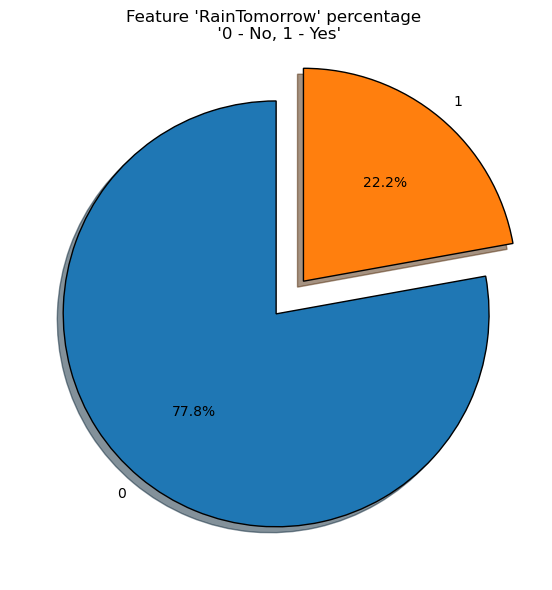

In [33]:
pie_plot(target)

#### Categorical Features

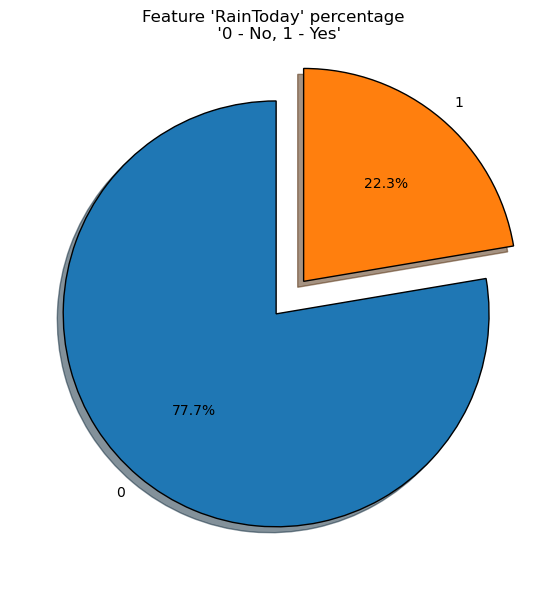

In [34]:
pie_plot("RainToday")

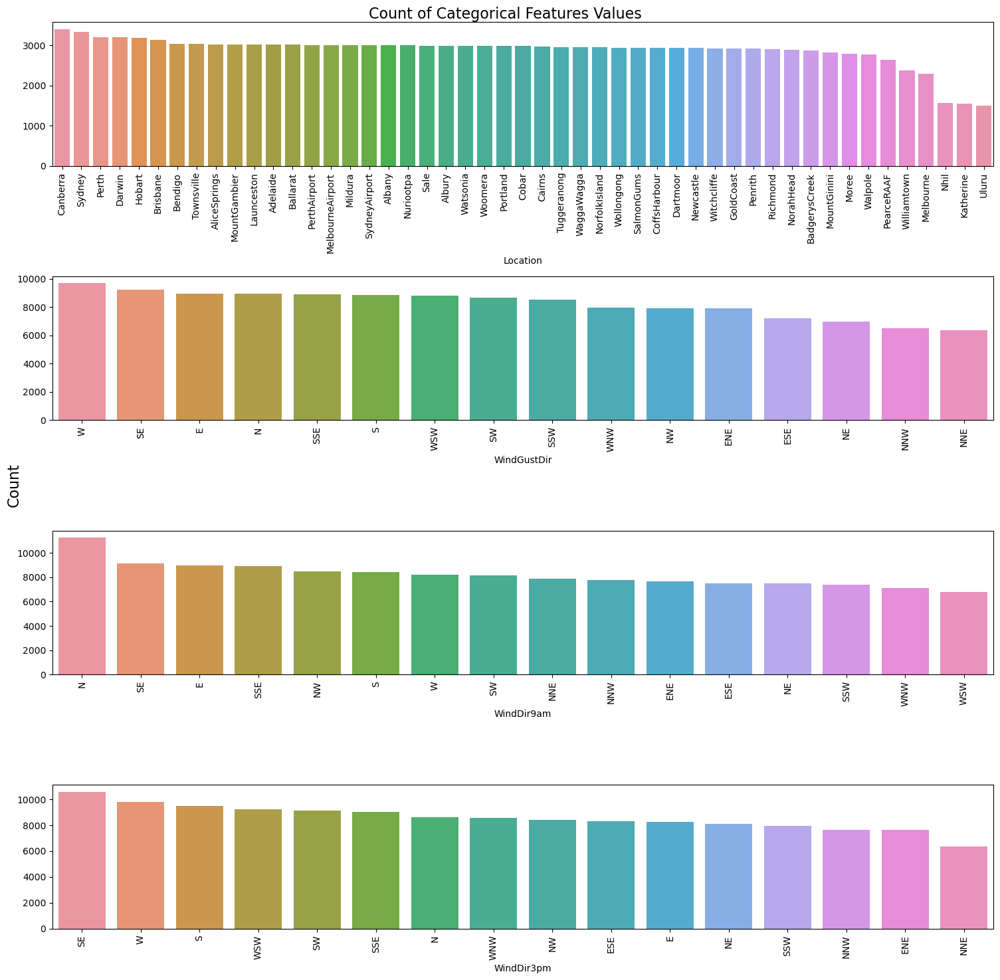

In [35]:
grid_cat_countplot()

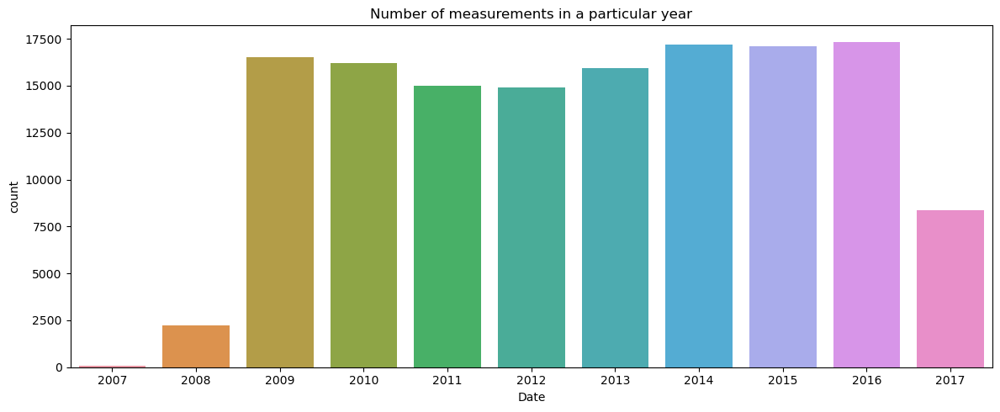

In [36]:
plt.figure(figsize=(12, 5))
sns.countplot(data=df, x=df["Date"].dt.year)
plt.title("Number of measurements in a particular year")
plt.tight_layout()
plt.show()

The highest number of measurements was conducted between 2014 and 2016. However, nearly throughout the entire range of years, the quantity of measurements remains relatively consistent.

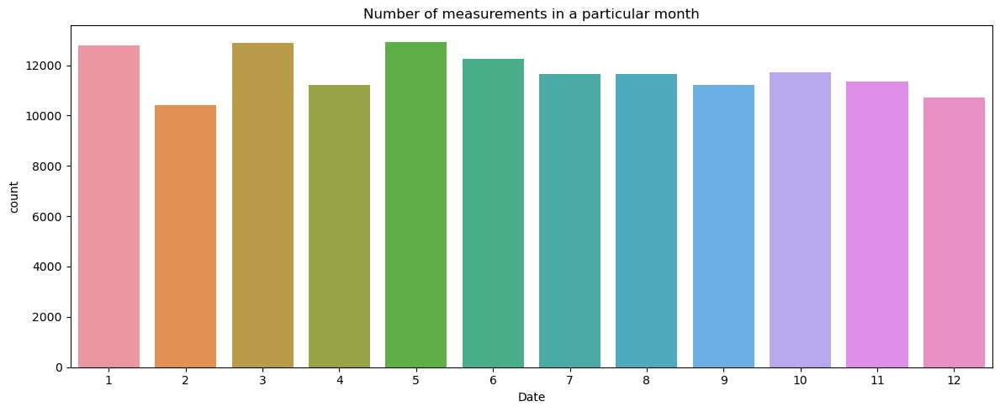

In [37]:
plt.figure(figsize=(12, 5))
sns.countplot(data=df, x=df["Date"].dt.month)
plt.title("Number of measurements in a particular month")
plt.tight_layout()
plt.show()

#### Numerical Features

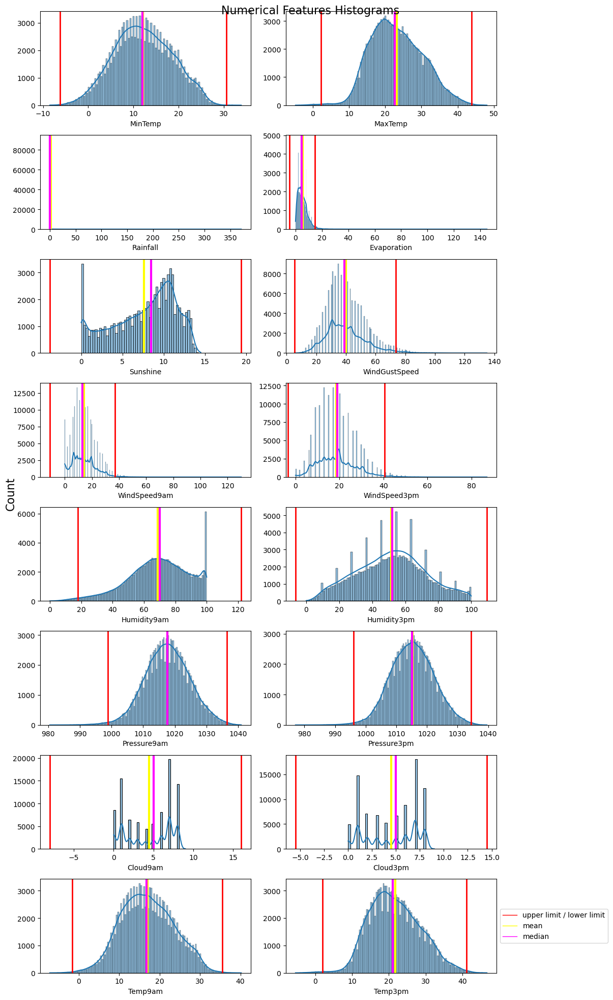

In [38]:
descriptive_plots(df)

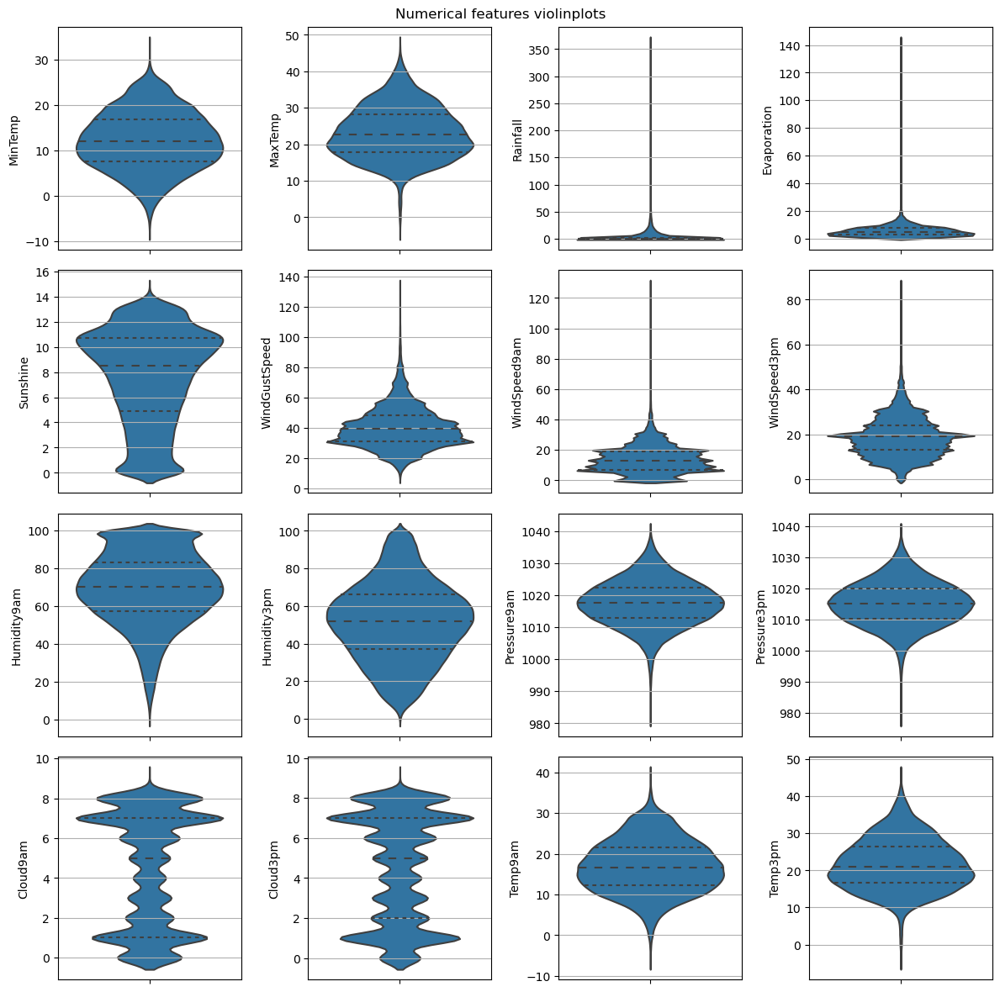

In [39]:
violin_plots(df)

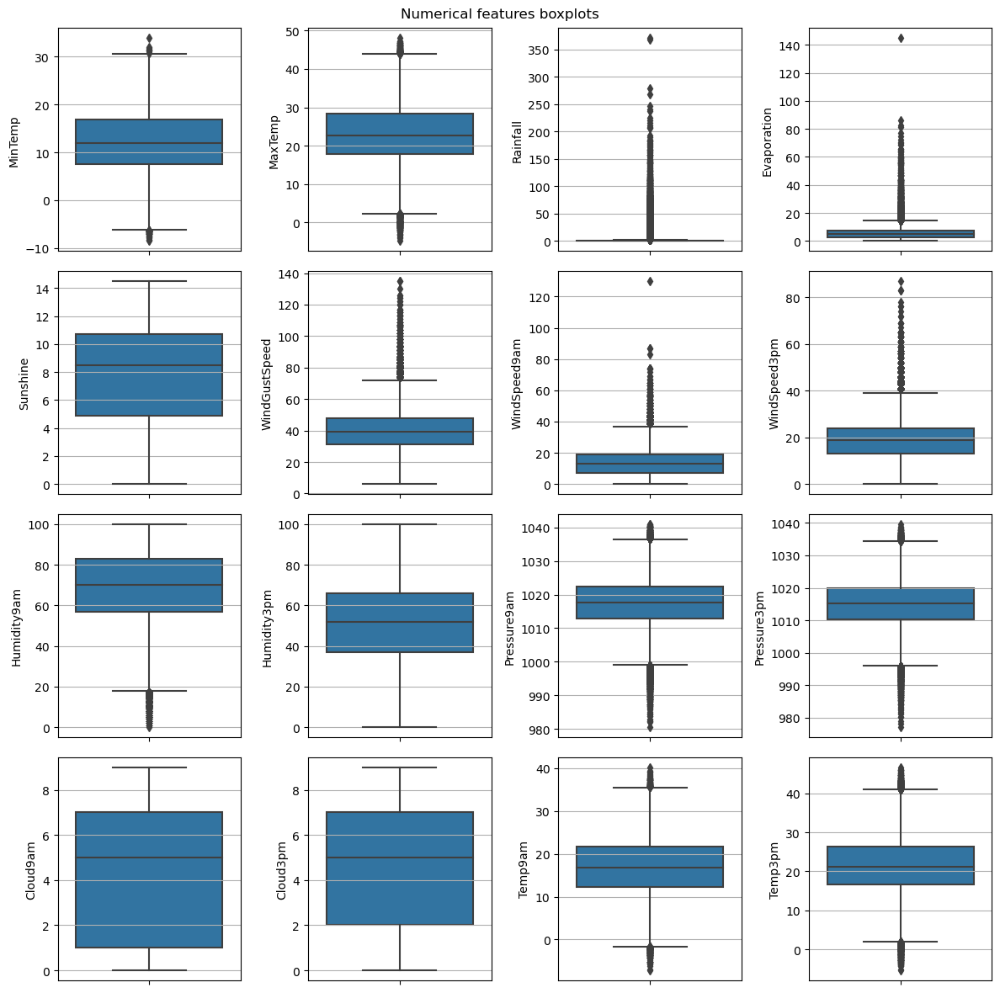

In [40]:
box_plots(df)

The distribution of our numerical features tends to be Gaussian. Additionally, we observe 'natural' outliers that do not represent significant anomalies but rather describe the variability in weather, which is inherent in every region around the world.

### Multivariate Analysis

In [41]:
df_grouped_loc = df.groupby("Location")["RainToday"].sum().reset_index().sort_values("RainToday", ascending=False)

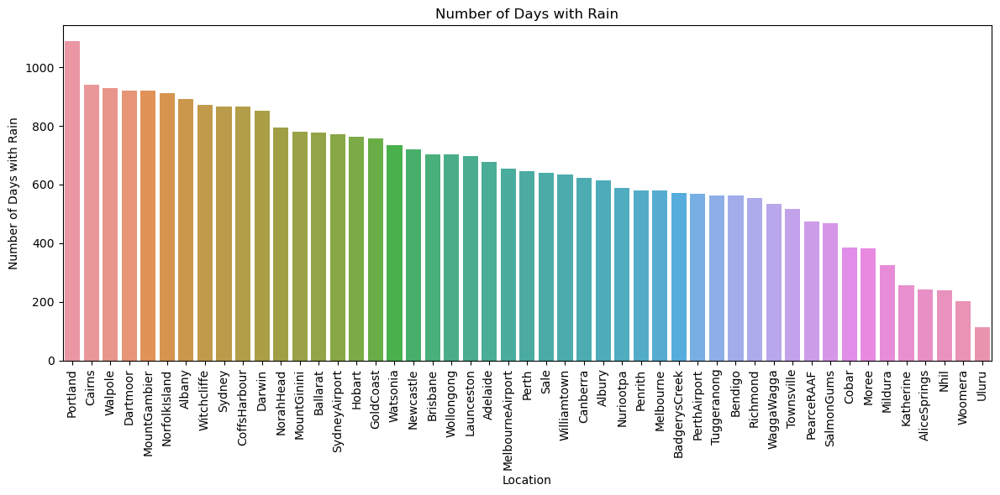

In [42]:
plt.figure(figsize=(12, 6))
sns.barplot(data=df_grouped_loc,
            x=df_grouped_loc.Location, y="RainToday")
plt.ylabel("Number of Days with Rain")
plt.title("Number of Days with Rain")
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()

As we can expect, the highest number of rainy days occurs in tropical regions near major oceanic currents, such as the northeastern part of Australia. Conversely, the lowest number of rainy days is typically found in continental areas with deserts.

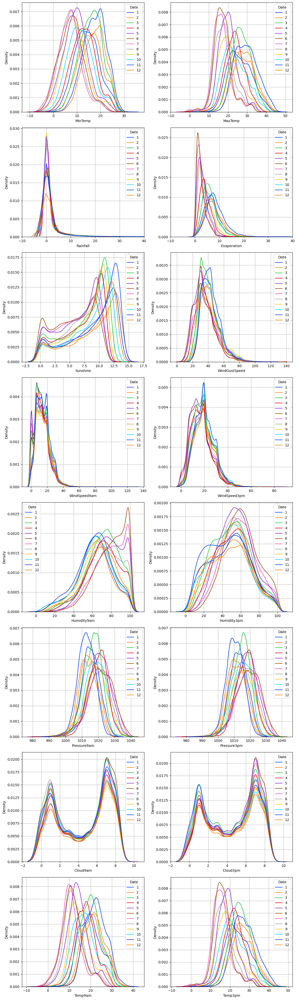

In [43]:
kde_plots(df, hue=df["Date"].dt.month, with_lim=True)

The minimum temperature has the highest number of low values for the months from May to September, while in the remaining months, significantly higher temperatures dominate. This is expected, considering that we are dealing with the Southern Hemisphere, where these months correspond to the autumn and winter seasons. This is associated with an increase in the number of values from 80 to 100 in humidity and, on average, higher atmospheric pressure.

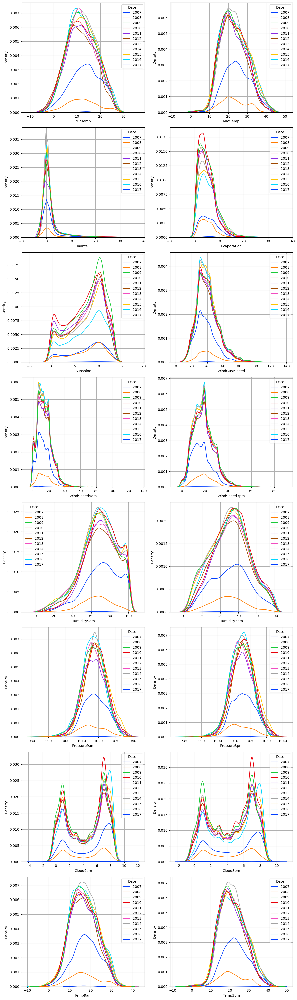

In [44]:
kde_plots(df, hue=df["Date"].dt.year, with_lim=True)

Over the 10-year period from 2007 to 2017, we do not observe significant weather changes.

In [45]:
categorical_features

['Date', 'Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday']

In [46]:
df["WindDir9am"].value_counts()

WindDir9am
N      11266
SE      9116
E       8977
SSE     8901
NW      8471
S       8424
W       8207
SW      8160
NNE     7877
NNW     7782
ENE     7668
ESE     7518
NE      7477
SSW     7397
WNW     7100
WSW     6786
Name: count, dtype: int64

In [47]:
df["WindDir3pm"].value_counts()

WindDir3pm
SE     10578
W       9810
S       9488
WSW     9231
SW      9104
SSE     9038
N       8593
WNW     8564
NW      8394
ESE     8311
E       8272
NE      8107
SSW     7945
NNW     7664
ENE     7645
NNE     6373
Name: count, dtype: int64

In [48]:
replace_map = {
    'SE': 'SE',
    'W': 'W',
    'S': 'S',
    'WSW': 'W',
    'SW': 'SW',
    'SSE': 'S',
    'N': 'N',
    'WNW': 'W',
    'NW': 'NW',
    'ESE': 'E',
    'E': 'E',
    'NE': 'NE',
    'SSW': 'S',
    'NNW': 'N',
    'ENE': 'E',
    'NNE': 'N'}

temp_df = df.replace(replace_map)

For visualization purposes, we can categorize wind directions into the 8 primary directions: N (North), NE (Northeast), E (East), SE (Southeast), S (South), SW (Southwest), W (West), NW (Northwest).

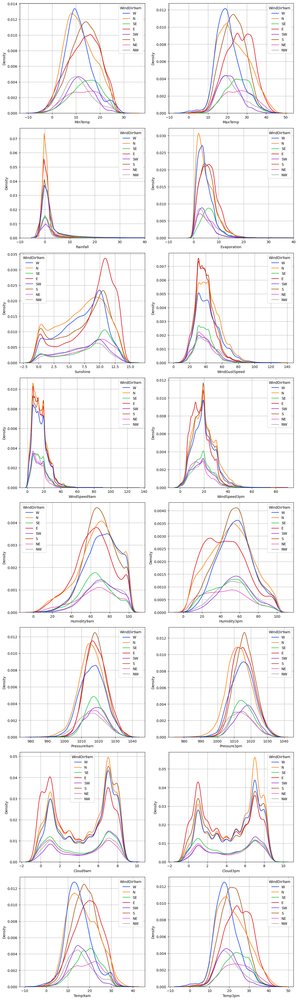

In [49]:
kde_plots(temp_df, hue=temp_df["WindDir9am"], with_lim=True)

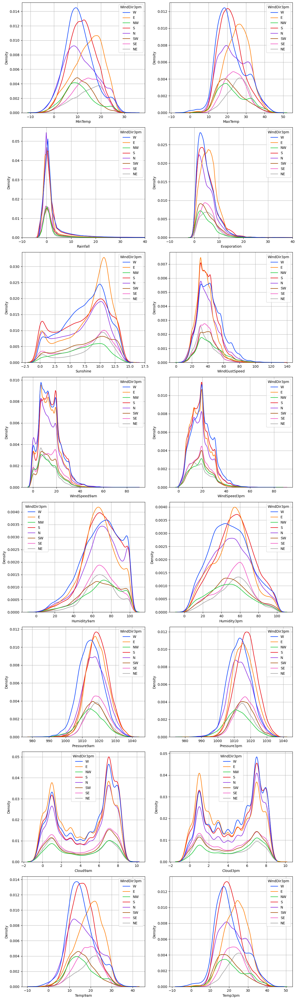

In [50]:
kde_plots(temp_df, hue=temp_df["WindDir3pm"], with_lim=True)

A significant number of hours with sunshine tends to occur with easterly winds. Additionally, higher maximum temperatures are observed for these wind directions. This is likely influenced by the Pacific Ocean, which generally has higher temperatures compared to the Indian Ocean in the vicinity of Australia.

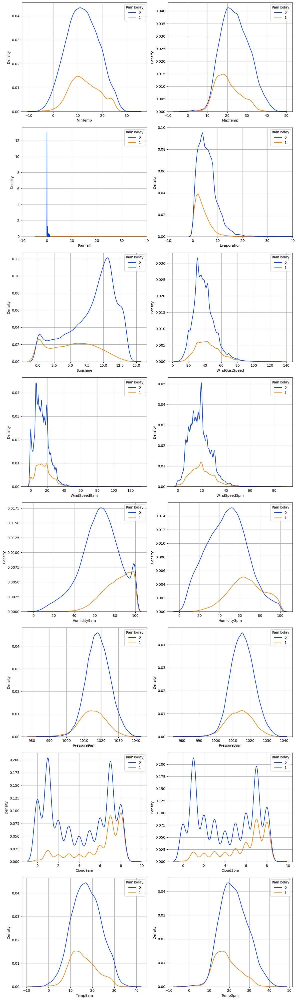

In [51]:
kde_plots(temp_df, hue=temp_df["RainToday"], with_lim=True)

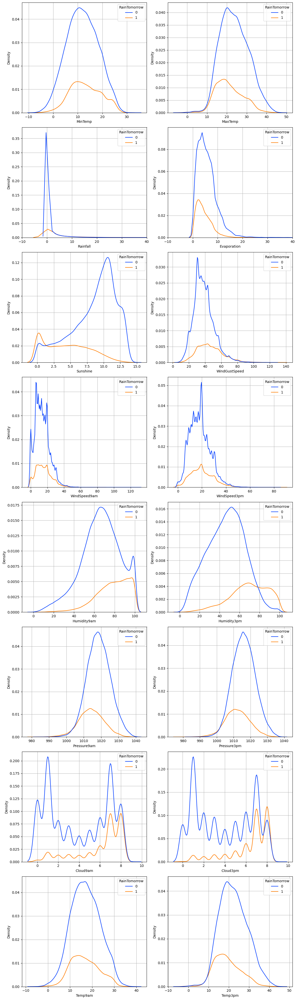

In [52]:
kde_plots(temp_df, hue=temp_df["RainTomorrow"], with_lim=True)

We can observe a logical connection between rainfall and the number of sunshine hours in a given day. If rainfall occurs, there is a lower number of sunshine hours. Similarly, we can notice the same pattern with cloud cover. When it rains, there is a significantly higher amount of time with clouds, taking into account the imbalance in the dataset.

- Numerical Features boxplots for Month as a Date

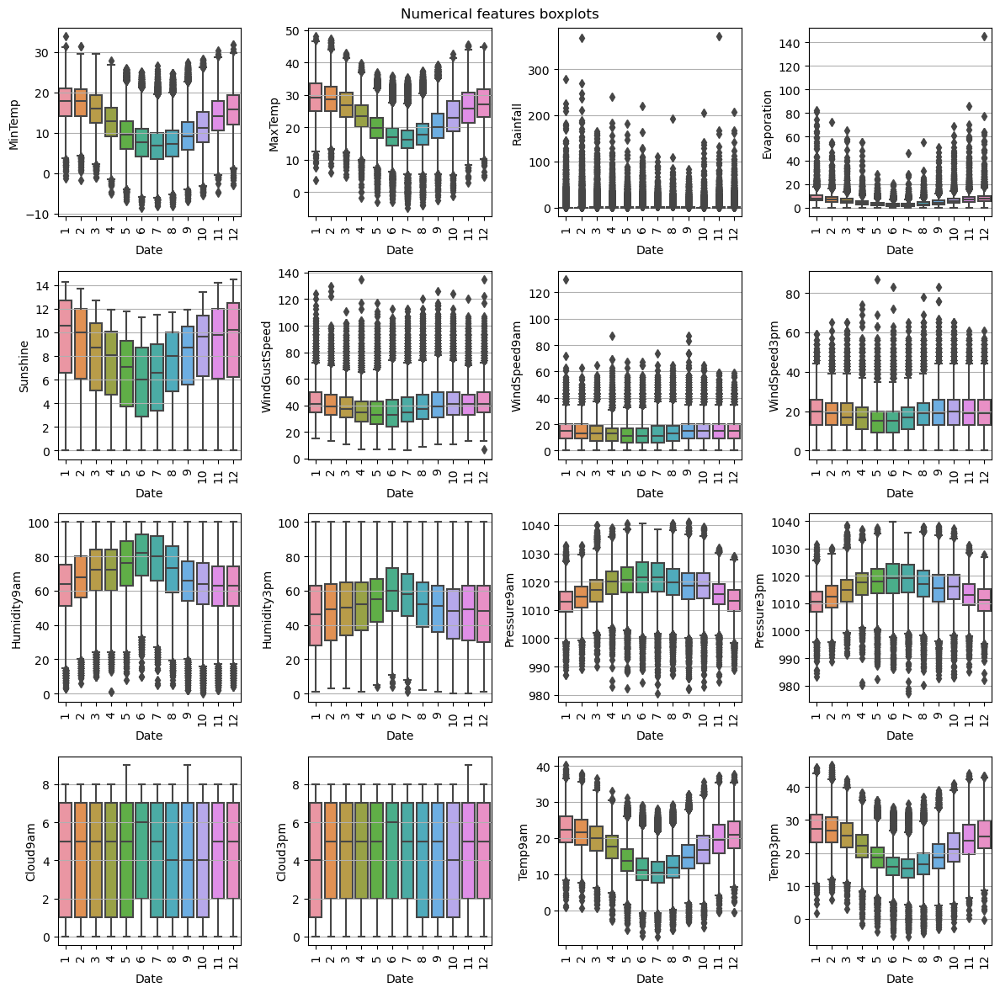

In [53]:
box_plots(temp_df, x=temp_df["Date"].dt.month)

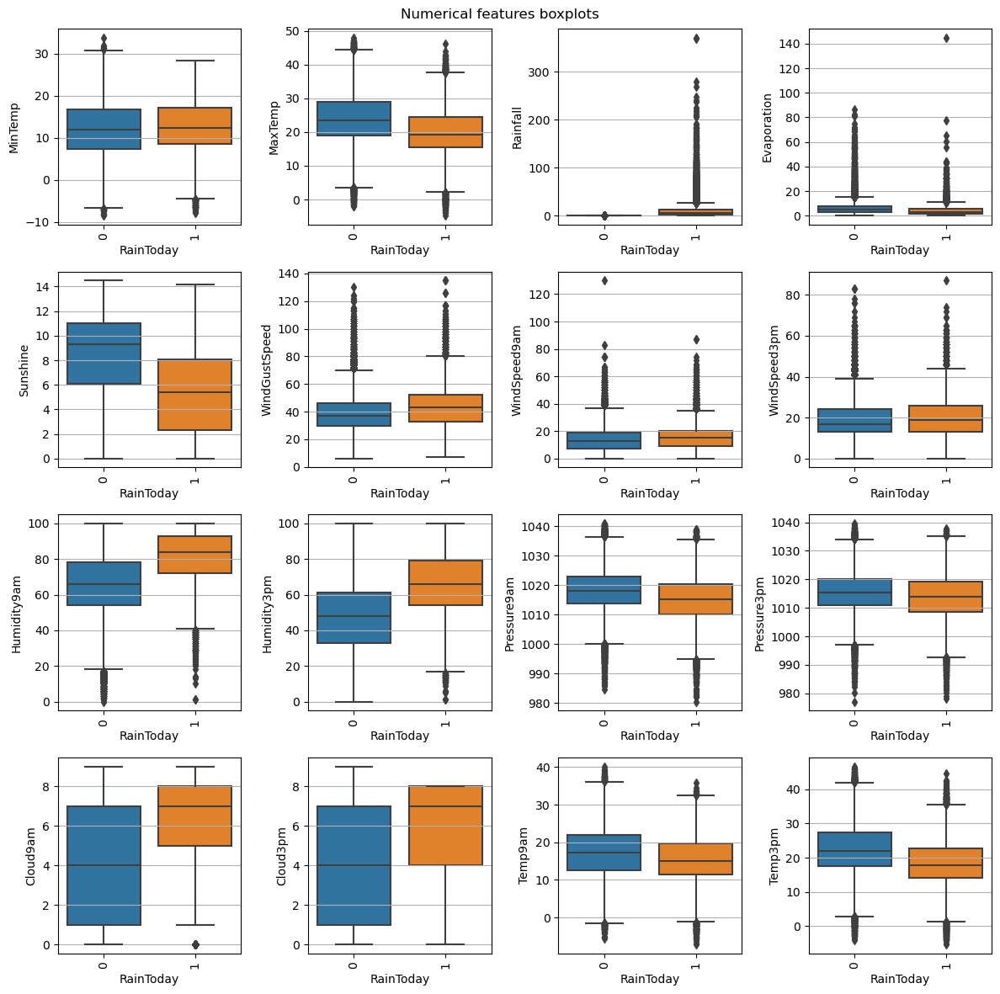

In [54]:
box_plots(df, x=df["RainToday"])

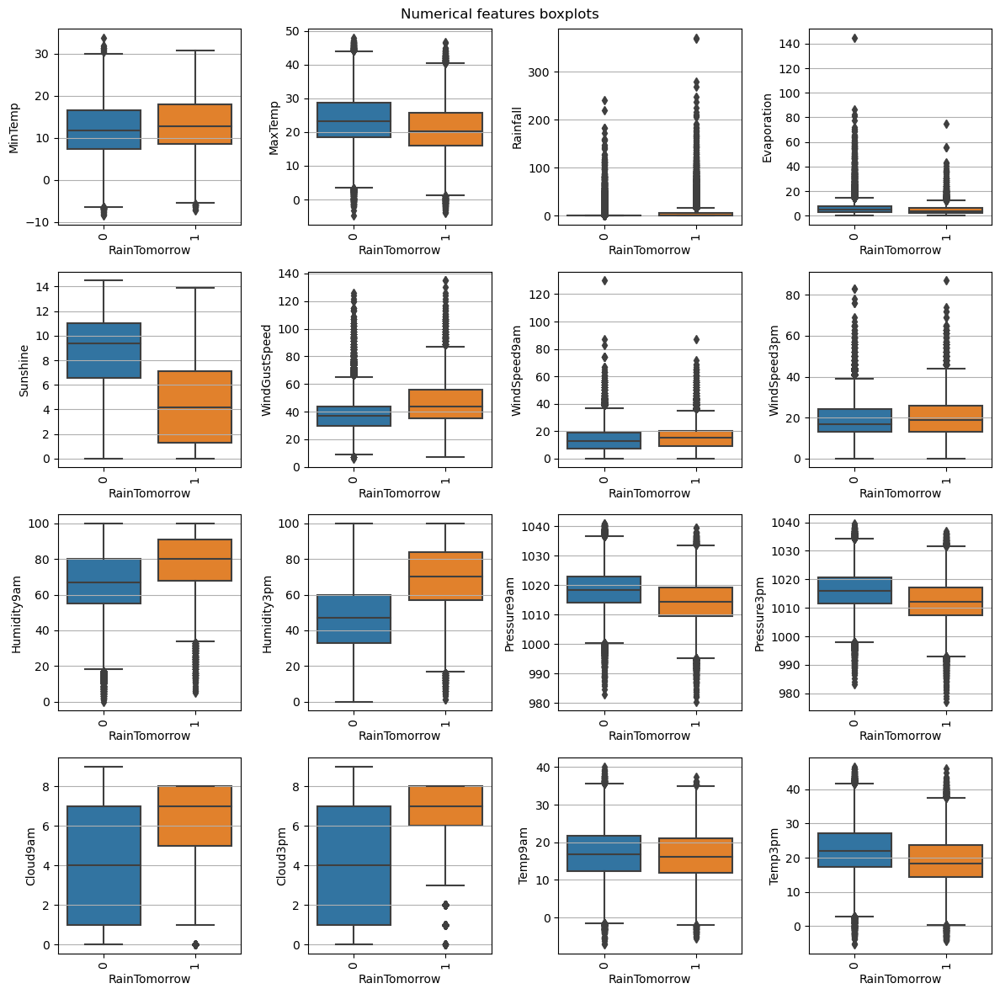

In [55]:
box_plots(df, x=df["RainTomorrow"])

- Pairplots

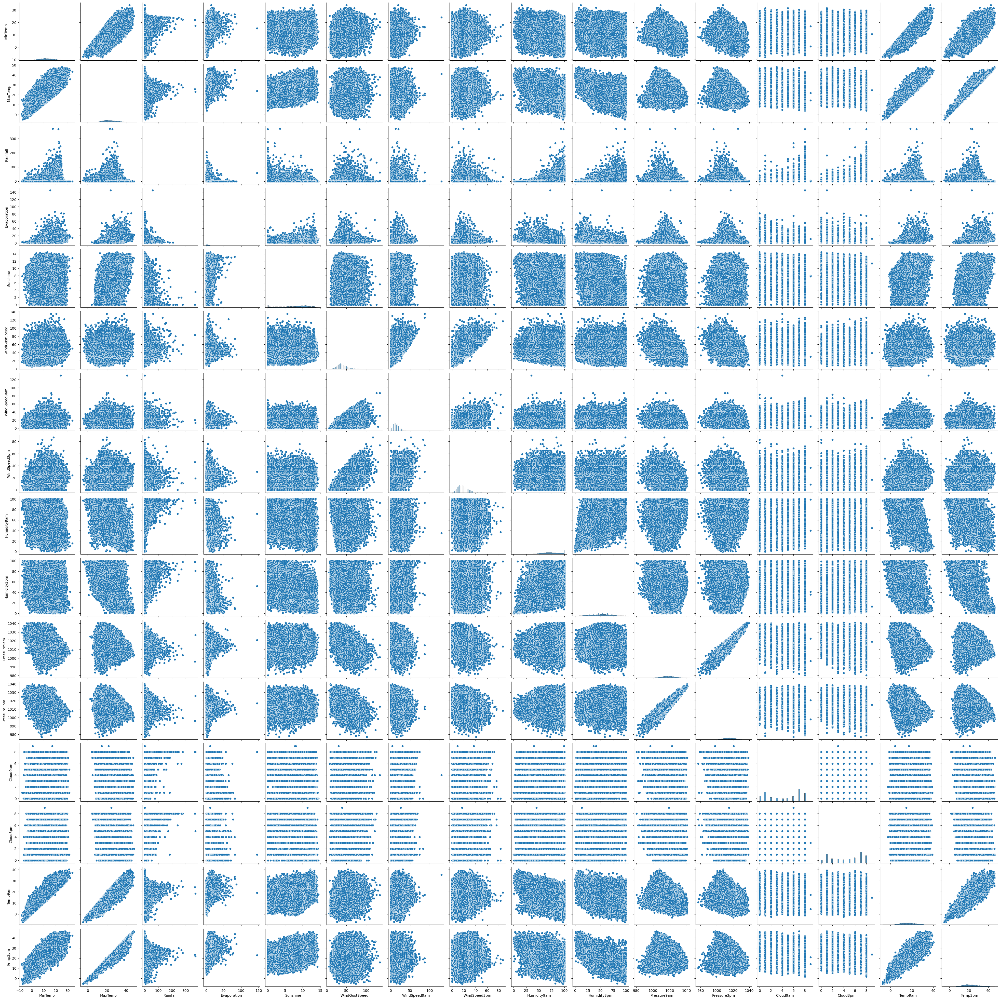

In [56]:
sns.pairplot(df[numerical_features])

- Correlations

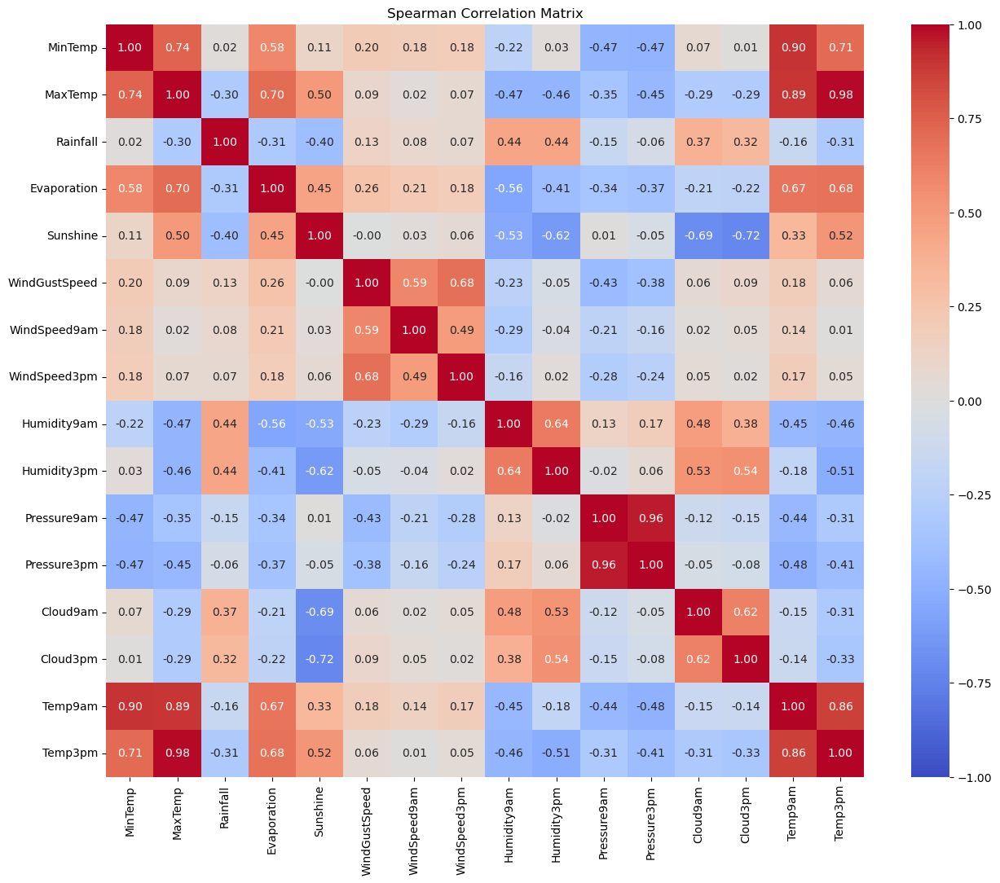

In [57]:
fig, ax = plt.subplots(figsize=(15, 12))
sns.heatmap(df[numerical_features].corr(method="spearman"), cmap="coolwarm", annot=True, fmt=".2f", vmin=-1, vmax=1)
plt.title("Spearman Correlation Matrix")
plt.show()

Some of the features are highly correlated with each other. Therefore, in the further analysis, statistical significance will be examined to make decisions about whether to remove certain features.

# Data Preparation

## Removing NaN values in categorical features

Due to the relatively small number of NaN values compared to the total number of observations, we can safely remove all NaN values from categorical features.

In [58]:
df = df[df["WindDir9am"].notna()]
df = df[df["WindDir3pm"].notna()]
df = df[df["WindGustDir"].notna()]

In [59]:
df.shape[0]

123710

<Axes: >

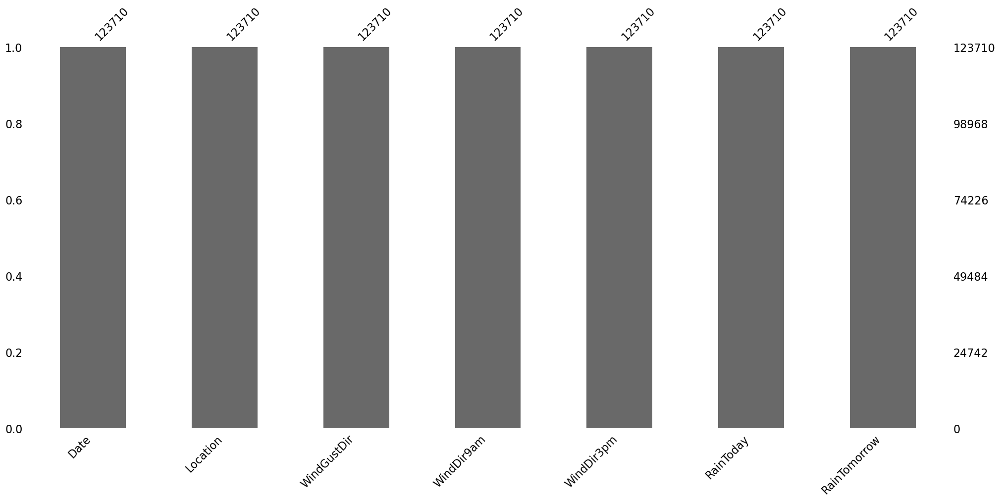

In [60]:
msno.bar(df[categorical_features+target_feature])

## Feature Engineering with 'Rainfall' Feature

Due to the highly skewed distribution of data for the 'Rainfall' feature, and the fact that over half of the values are zero, it has been transformed into a categorical feature. The value 1 indicates that Rainfall had a non-zero value, while 0 indicates its absence.

In [61]:
df["Rainfall"].value_counts()

Rainfall
0.0      79552
0.2       7411
0.4       3289
0.6       2244
0.8       1762
         ...  
118.0        1
164.2        1
69.4         1
87.0         1
69.0         1
Name: count, Length: 647, dtype: int64

In [62]:
df["Rainfall"] = df["Rainfall"].apply(lambda x: 1 if x > 0 else 0)

In [63]:
df["Rainfall"].value_counts()

Rainfall
0    79552
1    44158
Name: count, dtype: int64

In [64]:
numerical_features.remove("Rainfall")
categorical_features.append("Rainfall")

## Train Test Split with Stratification

In [65]:
y = df.pop(target)

In [66]:
df

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday
0,2008-12-01,Albury,13.4,22.9,1,NaN,NaN,W,44.0,W,...,24.0,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,0
1,2008-12-02,Albury,7.4,25.1,0,NaN,NaN,WNW,44.0,NNW,...,22.0,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,0
2,2008-12-03,Albury,12.9,25.7,0,NaN,NaN,WSW,46.0,W,...,26.0,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,0
3,2008-12-04,Albury,9.2,28.0,0,NaN,NaN,NE,24.0,SE,...,9.0,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,0
4,2008-12-05,Albury,17.5,32.3,1,NaN,NaN,W,41.0,ENE,...,20.0,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145454,2017-06-20,Uluru,3.5,21.8,0,NaN,NaN,E,31.0,ESE,...,13.0,59.0,27.0,1024.7,1021.2,NaN,NaN,9.4,20.9,0
145455,2017-06-21,Uluru,2.8,23.4,0,NaN,NaN,E,31.0,SE,...,11.0,51.0,24.0,1024.6,1020.3,NaN,NaN,10.1,22.4,0
145456,2017-06-22,Uluru,3.6,25.3,0,NaN,NaN,NNW,22.0,SE,...,9.0,56.0,21.0,1023.5,1019.1,NaN,NaN,10.9,24.5,0
145457,2017-06-23,Uluru,5.4,26.9,0,NaN,NaN,N,37.0,SE,...,9.0,53.0,24.0,1021.0,1016.8,NaN,NaN,12.5,26.1,0


The dataset was split into training and testing sets using stratification. This was done to ensure that the proportion of values, especially the numerous '0' values in the target feature, is preserved in both the training and testing sets. Stratified sampling helps maintain the distribution of the target variable in the subsets, preventing potential biases that may arise from an imbalanced distribution. In the context of this analysis, it is crucial to maintain the balance of occurrences of '0' an '1' values, ensuring a representative training and testing dataset for the predictive modeling task.

--- **Better results were observed for the implemented models after applying stratification** ---

In [67]:
X_train, X_test, y_train, y_test = train_test_split(df, y, test_size=0.3, stratify=y, random_state=0)

We can sort the data by index to later apply an imputation technique while preserving the date and location order in both the training and testing datasets.

In [68]:
X_train = X_train.sort_index()
X_test = X_test.sort_index()
y_train = y_train.sort_index()
y_test = y_test.sort_index()

In [69]:
X_train.head().T

,0,1,3,4,5
Date,2008-12-01 00:00:00,2008-12-02 00:00:00,2008-12-04 00:00:00,2008-12-05 00:00:00,2008-12-06 00:00:00
Location,Albury,Albury,Albury,Albury,Albury
MinTemp,13.4,7.4,9.2,17.5,14.6
MaxTemp,22.9,25.1,28.0,32.3,29.7
Rainfall,1,0,0,1,1
Evaporation,NaN,NaN,NaN,NaN,NaN
Sunshine,NaN,NaN,NaN,NaN,NaN
WindGustDir,W,WNW,NE,W,WNW
WindGustSpeed,44.0,44.0,24.0,41.0,56.0
WindDir9am,W,NNW,SE,ENE,W


In [70]:
X_test.head().T

,2,7,12,18,21
Date,2008-12-03 00:00:00,2008-12-08 00:00:00,2008-12-13 00:00:00,2008-12-19 00:00:00,2008-12-22 00:00:00
Location,Albury,Albury,Albury,Albury,Albury
MinTemp,12.9,7.7,15.9,11.2,17.1
MaxTemp,25.7,26.7,18.6,22.5,33.0
Rainfall,0,0,1,1,0
Evaporation,NaN,NaN,NaN,NaN,NaN
Sunshine,NaN,NaN,NaN,NaN,NaN
WindGustDir,WSW,W,W,SSE,NE
WindGustSpeed,46.0,35.0,61.0,43.0,43.0
WindDir9am,W,SSE,NNW,WSW,NE


In [71]:
y_train.head()

0    0
1    0
3    0
4    0
5    0
Name: RainTomorrow, dtype: int64

In [72]:
y_test.head()

2     0
7     0
12    1
18    0
21    0
Name: RainTomorrow, dtype: int64

## Numerical Features Imputation

The IterativeImputer was chosen for numerical features. This is a method used for imputing missing values in numerical features. It is implemented iteratively and models each feature with missing values as a function of other features. The imputation process is performed in multiple iterations until convergence. This approach helps capture the relationships and dependencies among features in order to provide more accurate imputations for missing values.

In [73]:
def join_test_train_cat_num(X_train_d, X_test_d, X_train, X_test):
    X_train_num = pd.DataFrame(X_train_d, columns=numerical_features, index=X_train.index)
    X_test_num = pd.DataFrame(X_test_d, columns=numerical_features, index=X_test.index)
    X_train = pd.concat([X_train_num, X_train[categorical_features]], axis=1)
    X_test = pd.concat([X_test_num, X_test[categorical_features]], axis=1)
    
    return X_train, X_test

In [74]:
iter_imputer = IterativeImputer(random_state=0).fit(X_train[numerical_features])
X_train_imputed = iter_imputer.transform(X_train[numerical_features])
X_test_imputed = iter_imputer.transform(X_test[numerical_features])

X_train, X_test = join_test_train_cat_num(X_train_imputed, X_test_imputed, X_train, X_test)

In [75]:
for feature in numerical_features:
    if feature not in ["MinTemp", "MaxTemp", "Temp9am", "Temp3pm"]:
        X_train = X_train[(X_train[feature] >= 0)]
        X_test = X_test[(X_test[feature] >= 0)]

y_train = y_train[X_train.index]
y_test = y_test[X_test.index]

Now, we can observe that there are no more missing values in the datasets.

<Axes: >

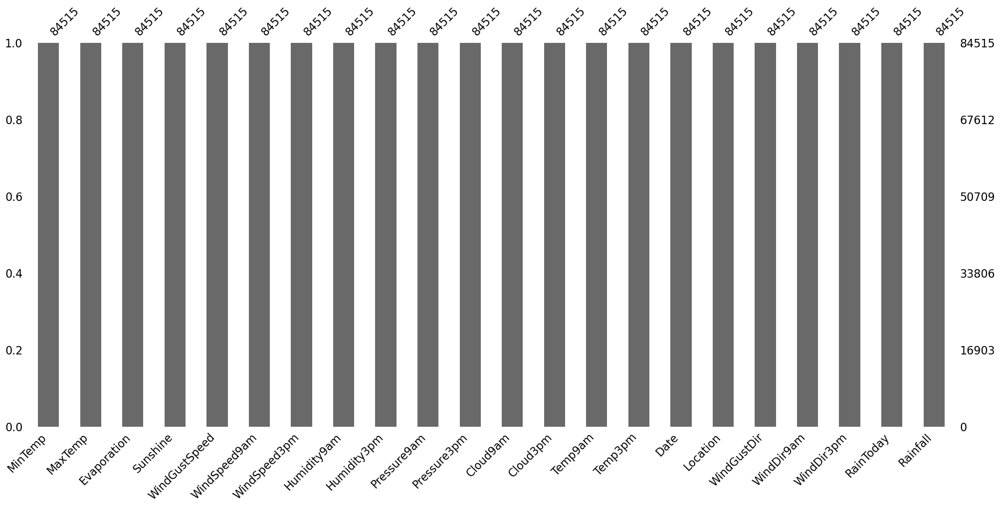

In [76]:
msno.bar(X_train)

<Axes: >

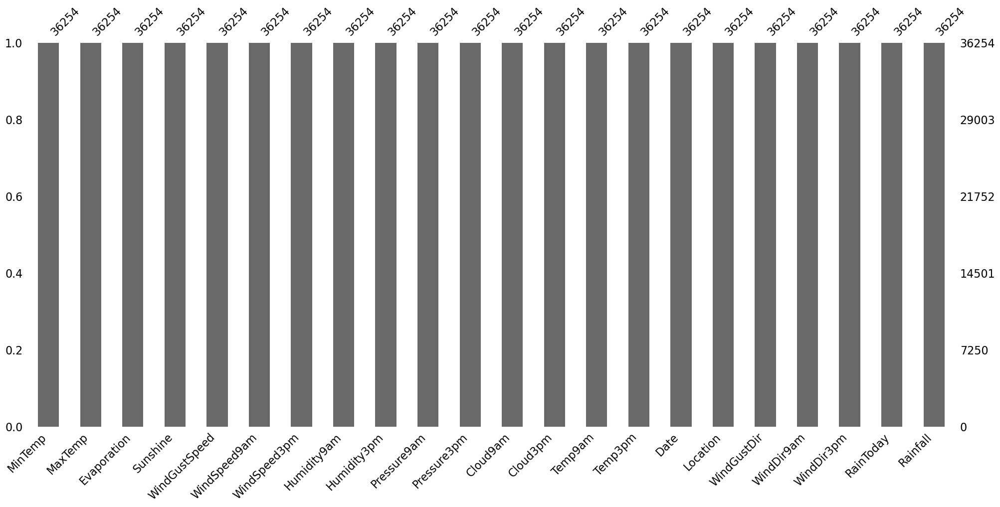

In [77]:
msno.bar(X_test)

In [78]:
X_train.head().T

,0,1,3,4,5
MinTemp,13.4,7.4,9.2,17.5,14.6
MaxTemp,22.9,25.1,28.0,32.3,29.7
Evaporation,6.352375,6.180632,6.852114,7.386797,8.018621
Sunshine,7.049827,10.830005,11.564541,5.570763,10.151469
WindGustSpeed,44.0,44.0,24.0,41.0,56.0
WindSpeed9am,20.0,4.0,11.0,7.0,19.0
WindSpeed3pm,24.0,22.0,9.0,20.0,24.0
Humidity9am,71.0,44.0,45.0,82.0,55.0
Humidity3pm,22.0,25.0,16.0,33.0,23.0
Pressure9am,1007.7,1010.6,1017.6,1010.8,1009.2


After imputation, it is essential to ensure that the data retains the original format. Therefore, in selected features, values need to be rounded to whole numbers:

In [79]:
for feature in ["Evaporation", "Sunshine", "WindSpeed9am", "WindSpeed3pm", "WindGustSpeed",
                "Humidity9am", "Humidity3pm", "Cloud9am", "Cloud3pm"]:
    X_train[feature] = X_train[feature].apply(lambda x: floor(x))
    X_test[feature] = X_test[feature].apply(lambda x: floor(x))

In [80]:
X_train.head().T

,0,1,3,4,5
MinTemp,13.4,7.4,9.2,17.5,14.6
MaxTemp,22.9,25.1,28.0,32.3,29.7
Evaporation,6,6,6,7,8
Sunshine,7,10,11,5,10
WindGustSpeed,44,44,24,41,56
WindSpeed9am,20,4,11,7,19
WindSpeed3pm,24,22,9,20,24
Humidity9am,71,44,45,82,55
Humidity3pm,22,25,16,33,23
Pressure9am,1007.7,1010.6,1017.6,1010.8,1009.2


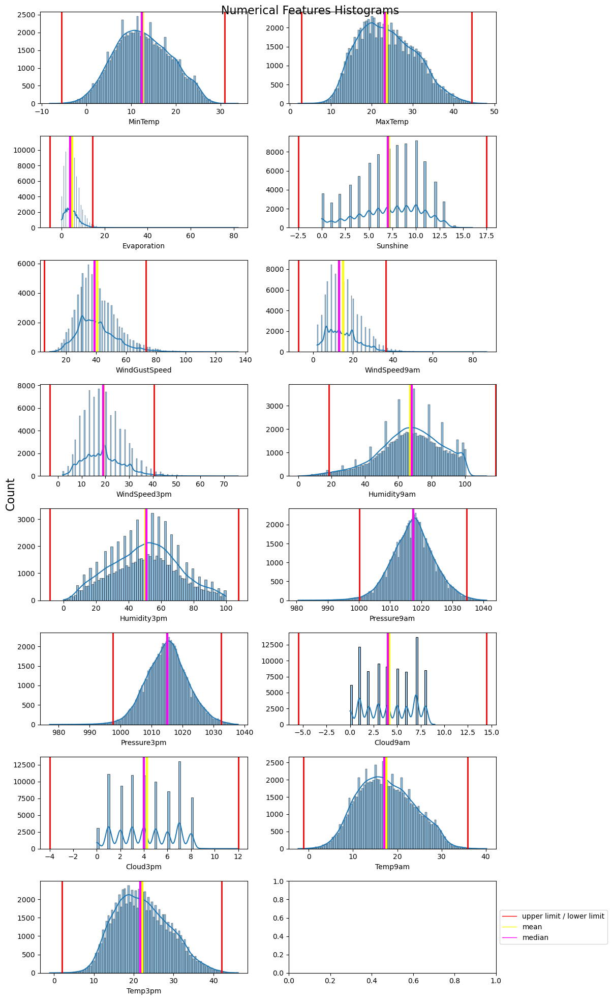

In [81]:
descriptive_plots(X_train)

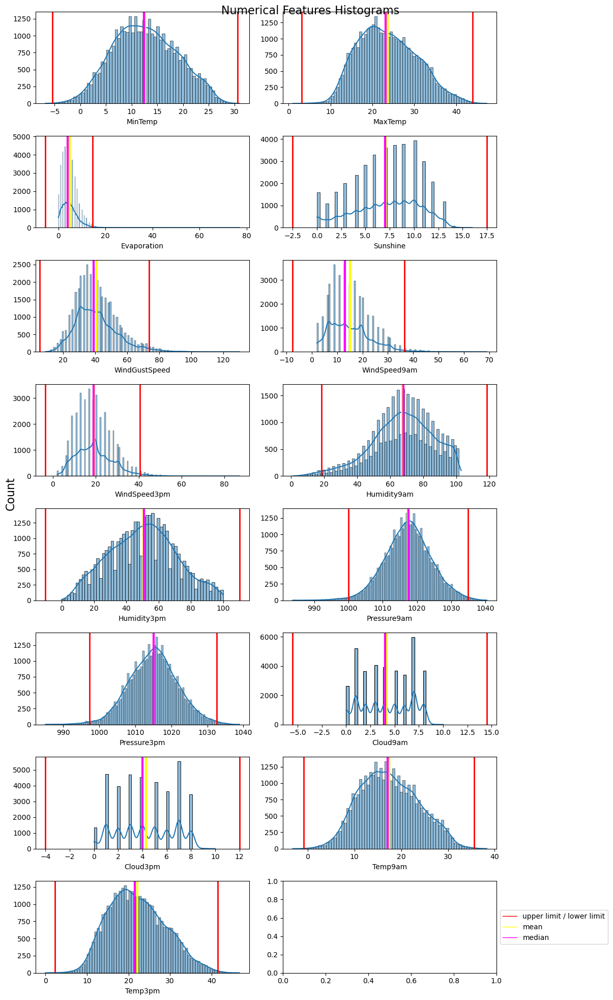

In [82]:
descriptive_plots(X_test)

## Numerical Features Standardization

Due to the distribution of our numerical features tending to be Gaussian, we can apply standardization to the numerical data.

In [83]:
std_scaler = StandardScaler().fit(X_train[numerical_features])
X_train_scaled = std_scaler.transform(X_train[numerical_features])
X_test_scaled = std_scaler.transform(X_test[numerical_features])

X_train, X_test = join_test_train_cat_num(X_train_scaled, X_test_scaled, X_train, X_test)

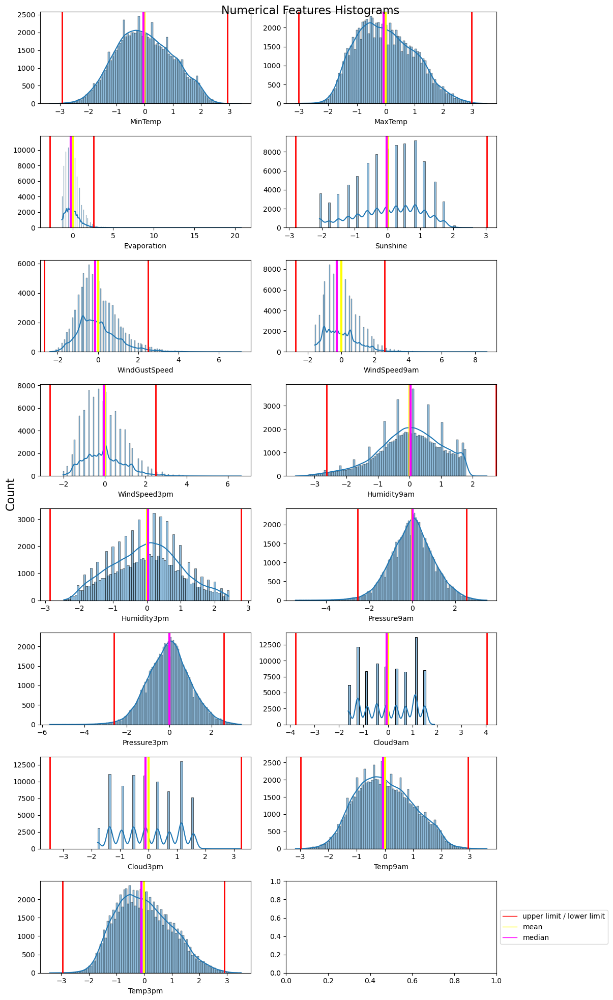

In [84]:
descriptive_plots(X_train)

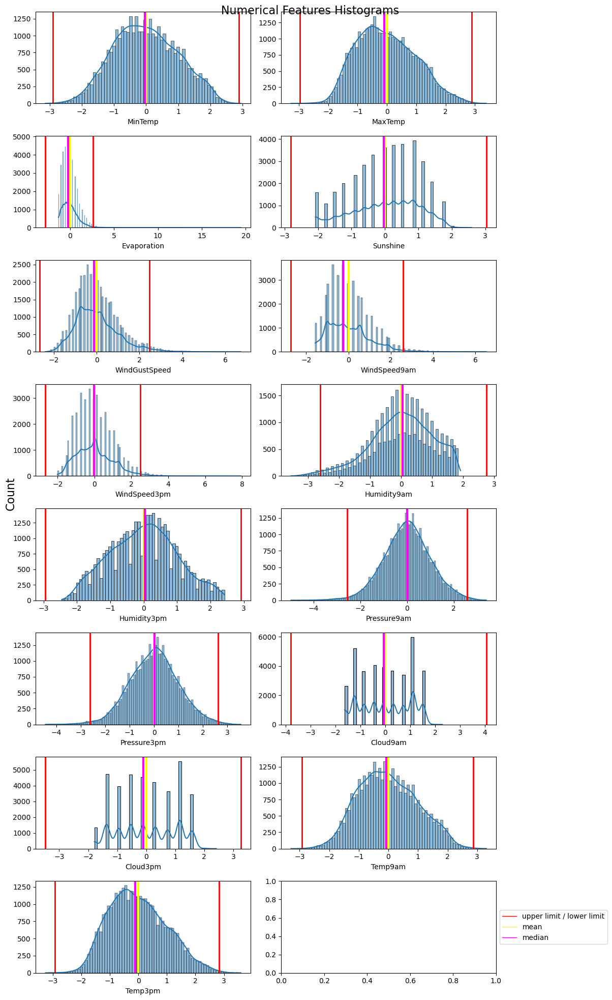

In [85]:
descriptive_plots(X_test)

## Numerical Features Correlation Importance

Now, we should check if all pairs of numerical features are statistically significant.

In [86]:
def check_correlation_importance(data, corr_type):
    cnt = 0
    feature_names = data.columns.values
    for f1 in feature_names:
        for f2 in feature_names:
            if corr_type == "pearson":
                statistic, pvalue = stats.pearsonr(data[f1], data[f2])
            elif corr_type == "spearman":
                statistic, pvalue = stats.spearmanr(data[f1], data[f2])
            else:
                return

            if statistic < 0.7 and statistic > -0.7:
                continue
            if pvalue > 0.05:
                cnt += 1
                print(f"Statistically insignificant correlation between {f1} and {f2} with correlation coefficient {statistic}", end="\n\n")
    if cnt == 0:
        print("All correlation pairs are statistically significant")

In [87]:
check_correlation_importance(X_train[numerical_features], "pearson")

All correlation pairs are statistically significant


In [88]:
check_correlation_importance(X_test[numerical_features], "pearson")

All correlation pairs are statistically significant


In [89]:
check_correlation_importance(X_train[numerical_features], "spearman")

All correlation pairs are statistically significant


In [90]:
check_correlation_importance(X_test[numerical_features], "spearman")

All correlation pairs are statistically significant


## Feature Engineering with Categorical Feature 'Date'

Due to the small changes in data across days and years for a given month, we can extract the month and year from the 'Date' feature and subsequently remove the 'Date' column.

In [91]:
X_train["Month"] = X_train["Date"].dt.month
X_train["Year"] = X_train["Date"].dt.year
X_test["Month"] = X_test["Date"].dt.month
X_test["Year"] = X_test["Date"].dt.year

In [92]:
X_train.drop(columns=["Date"], inplace=True)
X_test.drop(columns=["Date"], inplace=True)

In [93]:
X_train.head().T

,0,1,3,4,5
MinTemp,0.118586,-0.846743,-0.557144,0.778227,0.311652
MaxTemp,-0.120649,0.195712,0.612734,1.231077,0.857195
Evaporation,0.286469,0.286469,0.286469,0.556244,0.826019
Sunshine,-0.03403,0.841827,1.133779,-0.617934,0.841827
WindGustSpeed,0.248627,0.248627,-1.258486,0.02256,1.152895
WindSpeed9am,0.599852,-1.331973,-0.486799,-0.969755,0.479113
WindSpeed3pm,0.55794,0.323669,-1.199087,0.089399,0.55794
Humidity9am,0.198925,-1.247725,-1.194146,0.7883,-0.658349
Humidity3pm,-1.380002,-1.233693,-1.672621,-0.843535,-1.331232
Pressure9am,-1.426178,-0.999504,0.030396,-0.970079,-1.205485


In [94]:
X_test.head().T

,2,7,12,18,21
MinTemp,0.038142,-0.798476,0.520806,-0.235368,0.713872
MaxTemp,0.281992,0.425793,-0.738992,-0.17817,1.331737
Evaporation,0.826019,0.286469,-0.253081,0.556244,1.095794
Sunshine,1.133779,1.133779,-1.785742,0.841827,1.425731
WindGustSpeed,0.399338,-0.429574,1.529673,0.173271,0.173271
WindSpeed9am,0.479113,-1.090494,1.565765,1.082809,0.237635
WindSpeed3pm,0.79221,-0.262006,1.02648,-0.262006,0.323669
Humidity9am,-1.569203,-1.033407,0.466823,-1.086986,-1.569203
Humidity3pm,-0.989844,-1.526311,2.082649,-0.892305,-1.087384
Pressure9am,-1.44089,-0.587544,-3.397702,-1.176059,-0.558118


In [95]:
categorical_features.remove("Date")

In [96]:
categorical_features.extend(["Month", "Year"])

## Categorical Data Encoding

Each categorical feature can be encoded using one-hot encoding. However, a notable drawback of this technique is the significant increase in the number of dimensions, reaching up to 129 dimensions in this case. This may result in longer training and prediction times for the subsequent models to be implemented. Another alternative could be grouping localizations based on geographical coordinates. However, to keep the analysis concise, this will not be introduced.

It's worth mentioning that dimensionality reduction techniques, such as PCA, could be applied. However, in this analysis, dimensionality reduction was not used to preserve the original features. This decision was made to retain the original features, which will be necessary, among other reasons, for determining feature importance.

In [97]:
oh_encoder = OneHotEncoder(drop="first", sparse=False)

preprocessor = ColumnTransformer(
    transformers=[
        ("cat", oh_encoder, categorical_features)
    ])

X_train_cat_enc = preprocessor.fit_transform(X_train)
X_test_cat_enc = preprocessor.transform(X_test)

oh_feature_names = preprocessor.named_transformers_["cat"].get_feature_names_out(input_features=categorical_features)

X_train_cat_enc = pd.DataFrame(X_train_cat_enc, columns=oh_feature_names, index=X_train.index)
X_test_cat_enc = pd.DataFrame(X_test_cat_enc, columns=oh_feature_names, index=X_test.index)

X_train = pd.concat([X_train[numerical_features], X_train_cat_enc], axis=1)
X_test = pd.concat([X_test[numerical_features], X_test_cat_enc], axis=1)

In [98]:
X_train.T

,0,1,3,4,5,6,8,9,10,11,...,145448,145449,145450,145451,145452,145453,145454,145455,145457,145458
MinTemp,0.118586,-0.846743,-0.557144,0.778227,0.311652,0.263385,-0.476700,0.070320,0.118586,0.520806,...,-1.667272,-1.619006,-1.200697,-1.007631,-0.750210,-0.846743,-1.474207,-1.586828,-1.168519,-0.782388
MaxTemp,-0.120649,0.195712,0.612734,1.231077,0.857195,0.181332,1.173557,0.914716,0.957856,-0.293210,...,-0.336350,-0.178170,0.080672,-0.048749,-0.437011,-0.451391,-0.278830,-0.048749,0.454553,0.468933
Evaporation,0.286469,0.286469,0.286469,0.556244,0.826019,0.826019,0.826019,0.556244,0.826019,-0.522856,...,-0.253081,-0.253081,0.016694,0.286469,0.016694,-0.253081,-0.253081,0.016694,0.286469,0.286469
Sunshine,-0.034030,0.841827,1.133779,-0.617934,0.841827,1.133779,1.133779,0.841827,0.841827,-1.785742,...,0.549875,0.841827,0.841827,0.841827,-0.325982,0.257922,0.549875,0.841827,0.841827,0.841827
WindGustSpeed,0.248627,0.248627,-1.258486,0.022560,1.152895,0.700761,2.961430,-0.957063,-0.806352,-0.730997,...,-1.409197,-1.635264,-1.258486,-0.730997,0.022560,-0.429574,-0.730997,-0.730997,-0.278863,-0.957063
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Year_2013,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Year_2014,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Year_2015,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Year_2016,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


In [99]:
X_test.T

,2,7,12,18,21,24,28,30,31,37,...,145419,145425,145426,145428,145433,145435,145437,145439,145447,145456
MinTemp,0.038142,-0.798476,0.520806,-0.235368,0.713872,-0.010124,1.132181,-0.106657,-0.219279,0.552984,...,-1.007631,-0.476700,-0.814565,0.311652,-0.524967,-1.136342,-1.425940,-1.248963,-1.635095,-1.458118
MaxTemp,0.281992,0.425793,-0.738992,-0.178170,1.331737,1.245457,0.497694,0.095052,0.397033,2.180162,...,0.842815,0.900335,0.483313,0.368273,-0.149410,-0.623952,-0.566432,-0.437011,-0.365111,0.224472
Evaporation,0.826019,0.286469,-0.253081,0.556244,1.095794,0.826019,1.095794,0.556244,0.556244,1.365569,...,0.556244,0.556244,0.016694,0.556244,0.016694,0.016694,0.016694,0.286469,-0.253081,0.016694
Sunshine,1.133779,1.133779,-1.785742,0.841827,1.425731,1.425731,0.549875,0.841827,0.841827,1.717683,...,1.425731,1.425731,1.133779,0.257922,-0.325982,0.841827,0.549875,1.133779,0.841827,1.133779
WindGustSpeed,0.399338,-0.429574,1.529673,0.173271,0.173271,0.173271,0.399338,-0.128151,1.152895,1.228250,...,0.700761,0.022560,-1.258486,-0.278863,-0.429574,0.173271,-0.128151,-0.278863,-0.429574,-1.409197
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Year_2013,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Year_2014,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Year_2015,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Year_2016,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


# Oversampling Target Feature 'Yes' Category

The SMOTE technique was applied to the dataset, allowing an increase in the values of the minority class for the target feature. In this case, it involves increasing the occurrences of '1' or 'Yes' in the target feature.

- **Important Note #1 !!!**:

No separate analysis for undersampling was conducted, even though it is applicable for large datasets. This decision was made because there are not many features that could be randomly discarded. For instance, in the desert regions of Australia, the target value almost always takes the value '0' or 'No,' artificially creating an advantage for coastal areas where rainfall occurs more frequently.

- **Important Note #2 !!!**:

Initially, there was an intention to separately analyze models for data without using SMOTE and with its use. However, the computational costs and time required for this analysis were significantly high. It is worth mentioning that SMOTE slightly improved the results of the models, and due to these minor differences, no separate analysis was conducted for data without oversampling.

In [100]:
smote_over = SMOTE(sampling_strategy=1)
X_train, y_train = smote_over.fit_resample(X_train, y_train)

In [101]:
y_train.value_counts()

RainTomorrow
0    66055
1    66055
Name: count, dtype: int64

In [102]:
X_train.shape

(132110, 129)

# Modeling

- helper functions

In [103]:
def plot_conf_matrix(y_pred, X_test, y_test):    
    plt.figure(figsize=(8, 6))
    sns.heatmap(confusion_matrix(y_test, y_pred), annot=True, fmt="d", cmap="Purples",
                xticklabels=["False", "True"], yticklabels=["False", "True"])
    plt.xlabel("Predicted label")
    plt.ylabel("Actual label")
    plt.title("Confusion Matrix")
    plt.show()

In [104]:
def plot_roc_curve(y_pred_proba, X_test, y_test):
    with sns.axes_style("darkgrid"):
        y_pred_proba = pd.DataFrame(y_pred_proba)[1]
        fp_rate, tp_rate, threshold = roc_curve(y_test, y_pred_proba)
        plt.figure(figsize=(8, 6))
        plt.plot(fp_rate, tp_rate, color="red")
        plt.plot([0, 1], [0, 1], color="black", linestyle='--')
        plt.xlim([-0.01, 1])
        plt.ylim([0, 1.01])
        plt.xlabel("False Positive Rate")
        plt.ylabel("True Positive Rate")
        plt.title("ROC Curve")
        plt.show()

In [105]:
def get_results(model, y_pred, y_pred_proba, X_train, y_train, X_test, y_test, knn=False):
    y_pred_proba = y_pred_proba[:, 1]
    
    print(f"Precision: {precision_score(y_test, y_pred):.4f}")
    print(f"Recall: {recall_score(y_test, y_pred):.4f}")
    print(f"F1 score: {f1_score(y_test, y_pred):.4f}")
    print(f"ROC-AUC score : {roc_auc_score(y_test, y_pred_proba):.4f}")
    if not knn: # slow computation with knn
        print("-"*40)
        print(f"Train score: {model.score(X_train.values, y_train.values):.4f}")
        print(f"Test score: {model.score(X_test.values, y_test.values):.4f}")
    print("-"*40)
    print('\nClassification Report:\n', classification_report(y_test, y_pred))

In [106]:
def results(model, y_pred, y_pred_proba, X_train, y_train, X_test, y_test, knn=False):
    plot_conf_matrix(y_pred, X_test, y_test)
    print("-"*70)
    plot_roc_curve(y_pred_proba, X_test, y_test)
    print("-"*70)
    get_results(model, y_pred, y_pred_proba, X_train, y_train, X_test, y_test, knn)

## Logistic Regression

### Baseline Model

As a baseline model, the one with an l1 penalty parameter was chosen, although the model with an l2 penalty was later identified as optimal in the grid search process.

- L1 penalty

In [107]:
logreg_model = LogisticRegression(random_state=0, max_iter=1000000, penalty="l1", solver="liblinear")
logreg_model.fit(X_train, y_train)

LogisticRegression(max_iter=1000000, penalty='l1', random_state=0,
                   solver='liblinear')

In [108]:
y_pred = logreg_model.predict(X_test)
y_pred_proba = logreg_model.predict_proba(X_test)

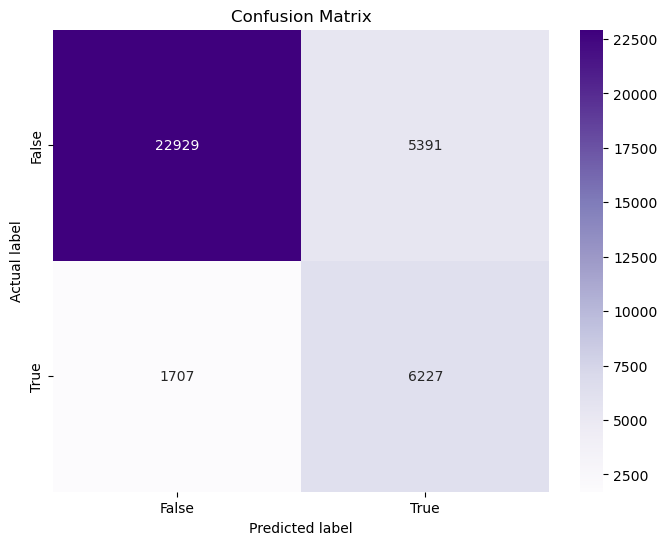

----------------------------------------------------------------------


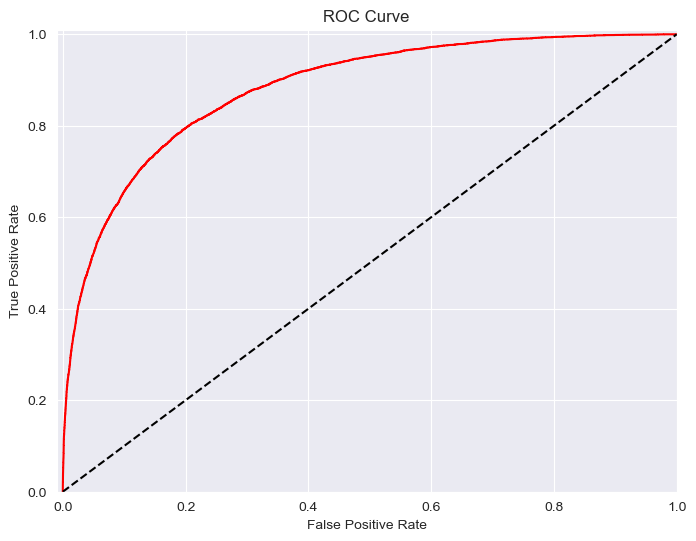

----------------------------------------------------------------------
Precision: 0.5360
Recall: 0.7849
F1 score: 0.6370
ROC-AUC score : 0.8815
----------------------------------------
Train score: 0.8067
Test score: 0.8042
----------------------------------------

Classification Report:
               precision    recall  f1-score   support

           0       0.93      0.81      0.87     28320
           1       0.54      0.78      0.64      7934

    accuracy                           0.80     36254
   macro avg       0.73      0.80      0.75     36254
weighted avg       0.84      0.80      0.82     36254



In [109]:
results(logreg_model, y_pred, y_pred_proba, X_train, y_train, X_test, y_test)

### Model Tuning

In [110]:
params = {"penalty": ["l1", "l2"],
          "max_iter": [100, 10000, 1000000]}
grid_search_logreg = GridSearchCV(estimator=logreg_model, param_grid=params, 
                                  refit="roc_auc", scoring=["f1", "roc_auc"], cv=10, n_jobs=-1)
grid_search_logreg.fit(X_train, y_train)

GridSearchCV(cv=10,
             estimator=LogisticRegression(max_iter=1000000, penalty='l1',
                                          random_state=0, solver='liblinear'),
             n_jobs=-1,
             param_grid={'max_iter': [100, 10000, 1000000],
                         'penalty': ['l1', 'l2']},
             refit='roc_auc', scoring=['f1', 'roc_auc'])

In [111]:
grid_search_logreg.best_params_, grid_search_logreg.best_score_

({'max_iter': 100, 'penalty': 'l2'}, 0.22804995252406282)

- L2 penalty

In [112]:
logreg_model_best = LogisticRegression(random_state=0, max_iter=1000000, penalty="l2")
logreg_model_best.fit(X_train, y_train)

LogisticRegression(max_iter=1000000, random_state=0)

In [113]:
y_pred = logreg_model_best.predict(X_test)
y_pred_proba = logreg_model_best.predict_proba(X_test)

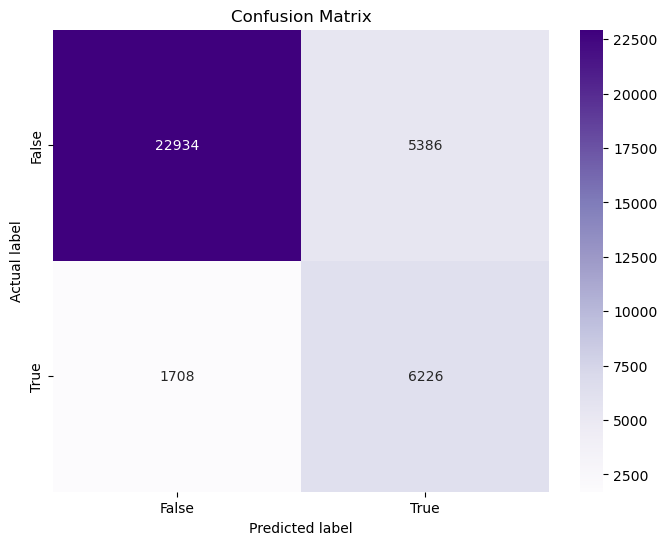

----------------------------------------------------------------------


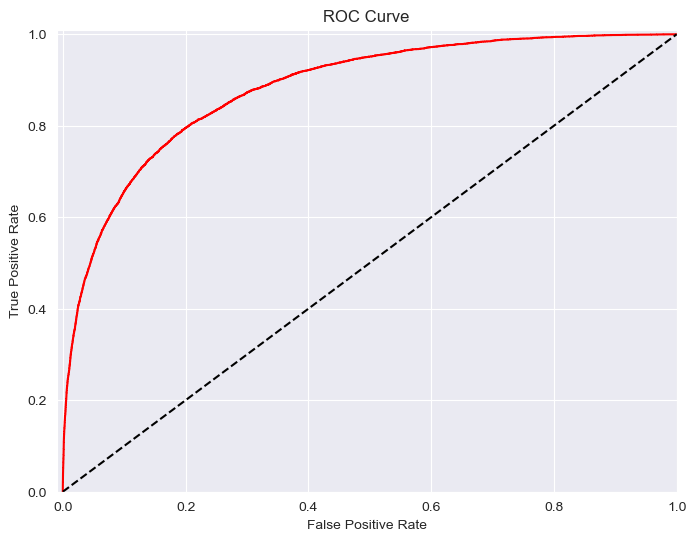

----------------------------------------------------------------------
Precision: 0.5362
Recall: 0.7847
F1 score: 0.6371
ROC-AUC score : 0.8815
----------------------------------------
Train score: 0.8067
Test score: 0.8043
----------------------------------------

Classification Report:
               precision    recall  f1-score   support

           0       0.93      0.81      0.87     28320
           1       0.54      0.78      0.64      7934

    accuracy                           0.80     36254
   macro avg       0.73      0.80      0.75     36254
weighted avg       0.84      0.80      0.82     36254



In [114]:
results(logreg_model_best, y_pred, y_pred_proba, X_train, y_train, X_test, y_test)

### Baseline Model vs Model after tuning

The model after tuning with the chosen parameters did not show significant improvement over the baseline model. Both models exhibit similar performance metrics, with the precision, recall, and F1 scores for class '1' (positive class) remaining relatively stable. The ROC-AUC score, which measures the model's ability to discriminate between positive and negative instances, also remained consistent. Therefore, the tuning process (in this case) did not lead to a substantial enhancement in the model's predictive capabilities. Importantly, there is no evidence of overfitting or underfitting, as the model's performance on the training set is comparable to that on the test set.

### Features Importance

Below there is a chart depicting feature importances in the context of rain prediction. The most crucial features are those derived from categorical features encoding based on location. Additionally, pressure and humidity have significant importance in rain prediction.

Conclusions:

- The location-based encoded features have great importance in our model, indicating that the geographical context plays a significant role in predicting rainfall. Different regions may exhibit distinct weather patterns and conditions, making location-based features valuable predictors.

- The importance of pressure suggests that atmospheric pressure is a key factor influencing rainfall. Changes in pressure can be indicative of weather systems and atmospheric conditions that contribute to the likelihood of precipitation.

- Humidity is a fundamental parameter in weather forecasting, and its significance in rain prediction aligns with expectations. Higher humidity levels often correlate with increased moisture in the air, creating conditions conducive to rainfall.

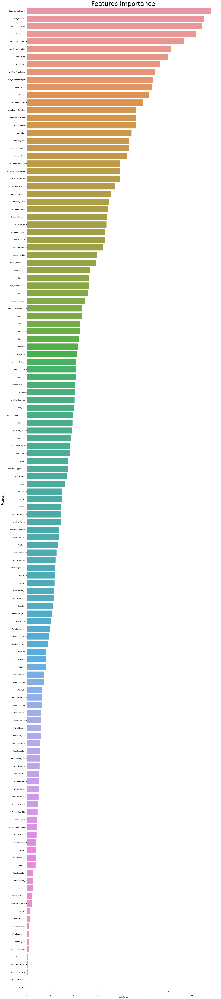

In [115]:
feature_importance = pd.DataFrame({"Feature": X_train.columns, "Importance": np.abs(logreg_model_best.coef_[0])})
feature_importance = feature_importance.sort_values("Importance", ascending=False)

plt.figure(figsize=(20, 90))
sns.barplot(data=feature_importance,
            y="Feature", x="Importance")
plt.ylabel("Feature", fontsize=20)
plt.title("Features Importance", fontsize=40)
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()

## K-Nearest Neighbors

**Important Note:**

The KNN (k-nearest neighbors) algorithm may be slow for this analysis due to the large number of data points and a significant number of dimensions in the dataset.

KNN relies on calculating distances between data points, and as the dataset size increases, the computational cost of evaluating distances for each query point requires more time.

### Baseline Model

**How different values of K impacts the model results** - Analysis with k = 1, 3, and 5

- k=1

In [116]:
knn_model = KNeighborsClassifier(n_neighbors=1, n_jobs=-1, metric="cosine")
knn_model.fit(X_train, y_train)

KNeighborsClassifier(metric='cosine', n_jobs=-1, n_neighbors=1)

In [117]:
y_pred = knn_model.predict(X_test.values)
y_pred_proba = knn_model.predict_proba(X_test.values)

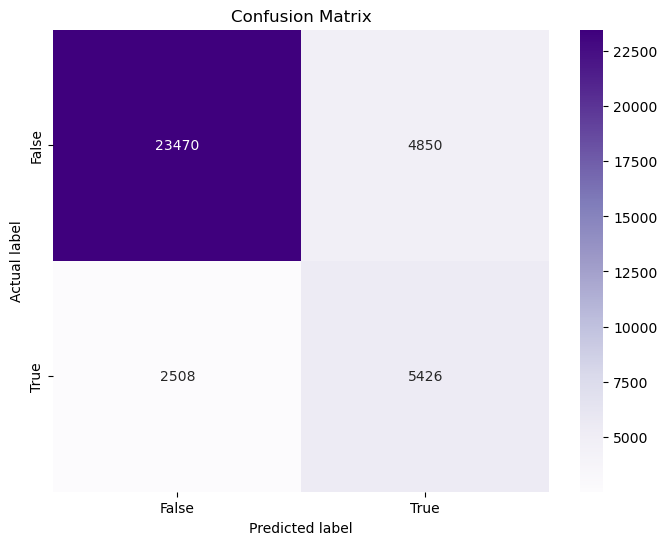

----------------------------------------------------------------------


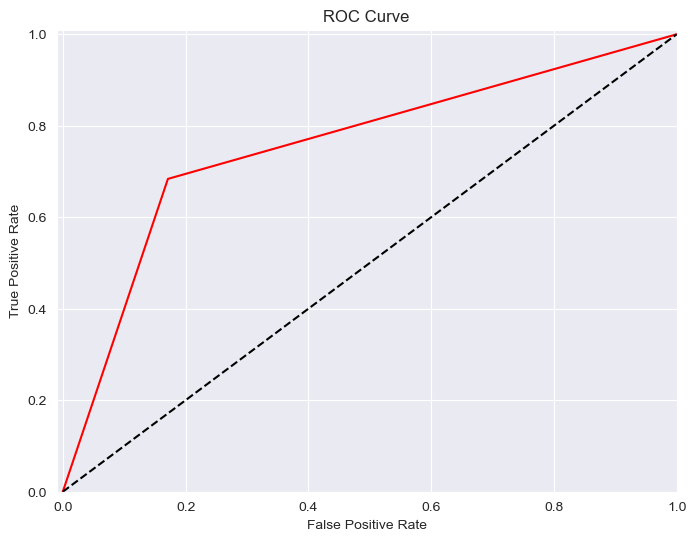

----------------------------------------------------------------------
Precision: 0.5280
Recall: 0.6839
F1 score: 0.5959
ROC-AUC score : 0.7563
----------------------------------------

Classification Report:
               precision    recall  f1-score   support

           0       0.90      0.83      0.86     28320
           1       0.53      0.68      0.60      7934

    accuracy                           0.80     36254
   macro avg       0.72      0.76      0.73     36254
weighted avg       0.82      0.80      0.81     36254



In [118]:
results(knn_model, y_pred, y_pred_proba, X_train, y_train, X_test, y_test, knn=True)

- k=3

In [119]:
knn_model = KNeighborsClassifier(n_neighbors=3, n_jobs=-1, metric="cosine")
knn_model.fit(X_train, y_train)

KNeighborsClassifier(metric='cosine', n_jobs=-1, n_neighbors=3)

In [120]:
y_pred = knn_model.predict(X_test.values)
y_pred_proba = knn_model.predict_proba(X_test.values)

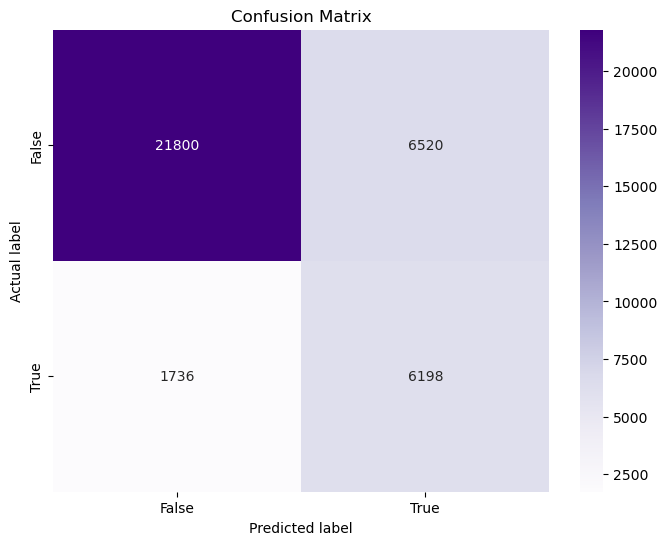

----------------------------------------------------------------------


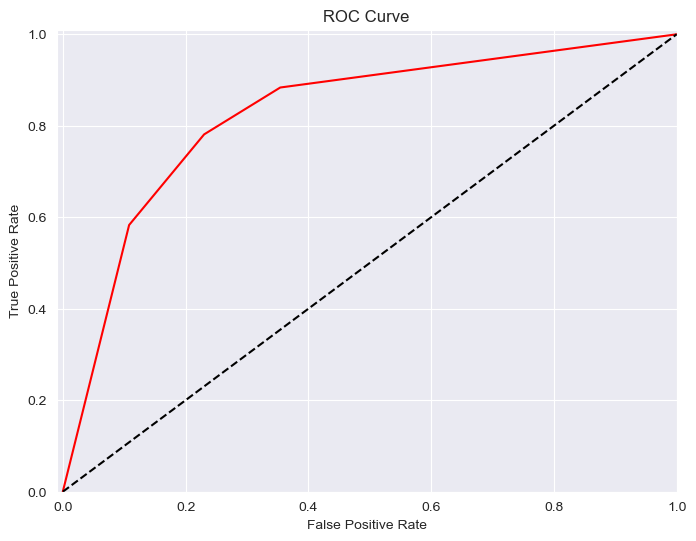

----------------------------------------------------------------------
Precision: 0.4873
Recall: 0.7812
F1 score: 0.6002
ROC-AUC score : 0.8263
----------------------------------------

Classification Report:
               precision    recall  f1-score   support

           0       0.93      0.77      0.84     28320
           1       0.49      0.78      0.60      7934

    accuracy                           0.77     36254
   macro avg       0.71      0.78      0.72     36254
weighted avg       0.83      0.77      0.79     36254



In [121]:
results(knn_model, y_pred, y_pred_proba, X_train, y_train, X_test, y_test, knn=True)

- k=5

In [122]:
knn_model = KNeighborsClassifier(n_neighbors=5, n_jobs=-1, metric="cosine")
knn_model.fit(X_train, y_train)

KNeighborsClassifier(metric='cosine', n_jobs=-1)

In [123]:
y_pred = knn_model.predict(X_test.values)
y_pred_proba = knn_model.predict_proba(X_test.values)

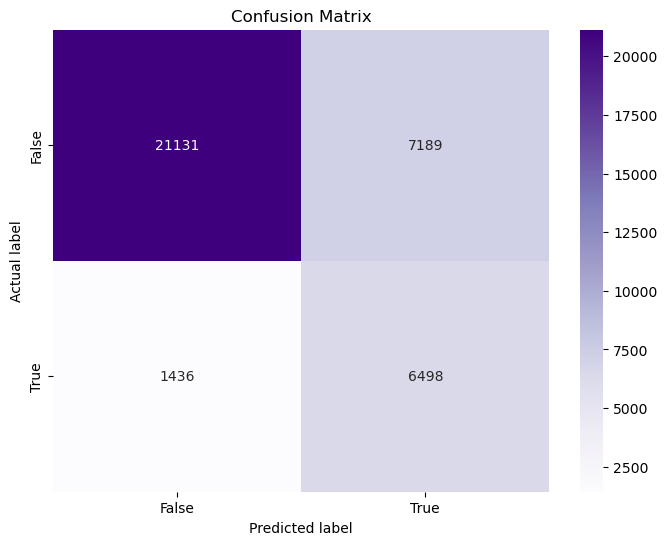

----------------------------------------------------------------------


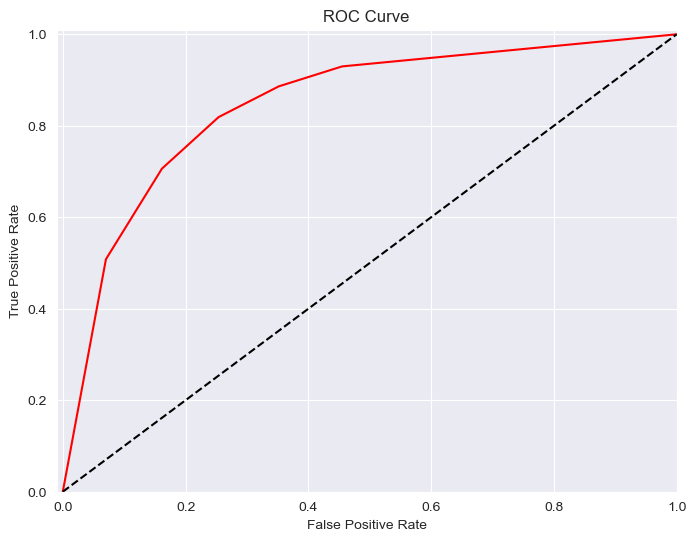

----------------------------------------------------------------------
Precision: 0.4748
Recall: 0.8190
F1 score: 0.6011
ROC-AUC score : 0.8468
----------------------------------------

Classification Report:
               precision    recall  f1-score   support

           0       0.94      0.75      0.83     28320
           1       0.47      0.82      0.60      7934

    accuracy                           0.76     36254
   macro avg       0.71      0.78      0.72     36254
weighted avg       0.84      0.76      0.78     36254



In [124]:
results(knn_model, y_pred, y_pred_proba, X_train, y_train, X_test, y_test, knn=True)

### How different values of K impacts the metrics

For k=1, the model exhibits relatively higher precision, but slightly lower recall. This indicates that when predicting the positive class, the model is precise but might miss some actual positive instances. The F1 score, a harmonic mean of precision and recall, is moderate. The ROC-AUC score, which measures the model's ability to discriminate between positive and negative instances.

For k=3, precision decreases slightly, while recall increases. The F1 score remains at a similar level. The ROC-AUC score improves, indicating better discrimination between classes compared to k=1.

For k=5, precision further decreases, while recall increases significantly. The F1 score remains relatively stable. The ROC-AUC score continues to improve, suggesting better overall model performance in distinguishing between positive and negative instances

### Model Tuning

Due to the considerable amount of time required for model execution, a grid search was not conducted during model tuning. This decision was made considering the substantial computational cost and time associated with grid search.

In [125]:
# params = {"metric": ["euclidean", "manhattan", "cosine"], 
#           "n_neighbors": [1, 3, 5]}
# grid_search_knn = GridSearchCV(estimator=knn_model, param_grid=params, 
#                                refit="roc_auc", scoring=["f1", "roc_auc"], cv=10, n_jobs=-1)
# grid_search_knn.fit(X_train, y_train)

**Important Notes - Which metric is appropriate for a particular task?**

Euclidean distance is suitable for datasets with continuous features and where the underlying geometry adheres to the Euclidean space. Manhattan distance, on the other hand, is well-suited for data with a grid-like structure or when each feature signifies a step-wise change. It is particularly advantageous in scenarios where sensitivity to outliers needs to be minimized. Manhattan distance is often preferred when the data exhibits a more step-wise or city-block-like arrangement.

Cosine similarity proves to be beneficial when working with high-dimensional spaces and demonstrates robustness to the scale of the data. It becomes particularly effective when the primary focus is on assessing the similarity between instances rather than their absolute distances.

**Conclusion:**

The cosine similarity metric should be a good choice when dealing with high-dimensional data, such as predicting rainfall in Australia with 129 features.

## Naive Bayes

### Baseline Model

In [126]:
bayes_model = GaussianNB()
bayes_model.fit(X_train, y_train)

GaussianNB()

In [127]:
y_pred = bayes_model.predict(X_test.values)
y_pred_proba = bayes_model.predict_proba(X_test.values)

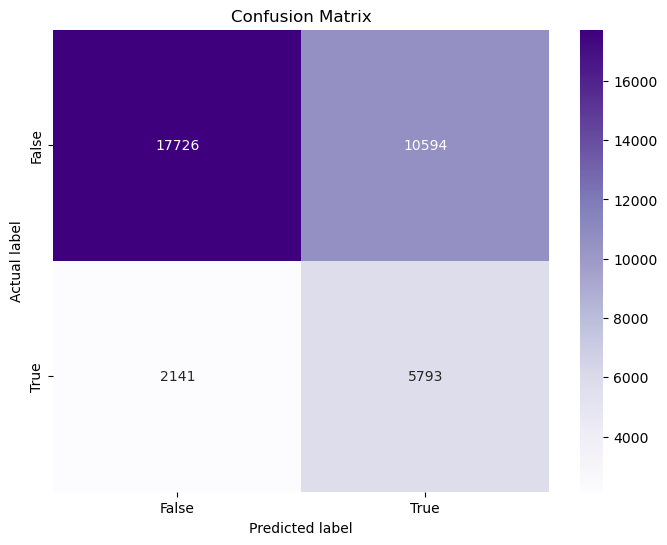

----------------------------------------------------------------------


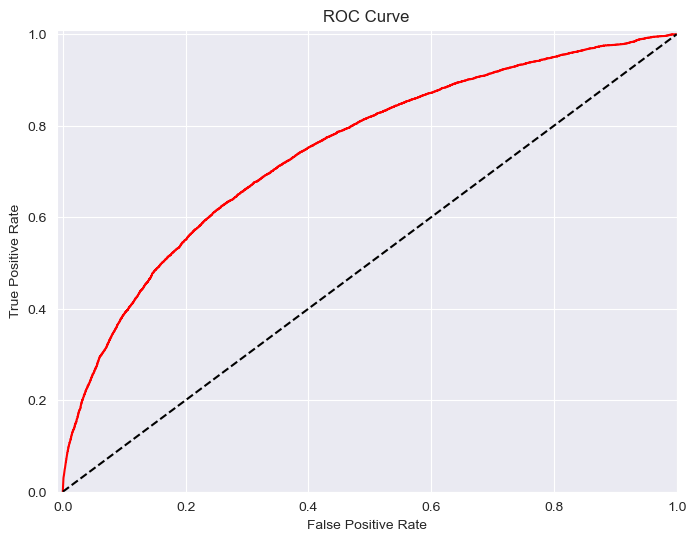

----------------------------------------------------------------------
Precision: 0.3535
Recall: 0.7301
F1 score: 0.4764
ROC-AUC score : 0.7460
----------------------------------------
Train score: 0.7058
Test score: 0.6487
----------------------------------------

Classification Report:
               precision    recall  f1-score   support

           0       0.89      0.63      0.74     28320
           1       0.35      0.73      0.48      7934

    accuracy                           0.65     36254
   macro avg       0.62      0.68      0.61     36254
weighted avg       0.77      0.65      0.68     36254



In [128]:
results(bayes_model, y_pred, y_pred_proba, X_train, y_train, X_test, y_test)

### Model Tuning

'var_smoothing' hyperparameter represents the portion of the largest variance of all features that is added to the covariance matrix for numerical stability. It is used for improving potentially the classifier's performance.

In [129]:
params = {"var_smoothing": np.logspace(0, -9, num=100)}

grid_search_bayes = GridSearchCV(estimator=bayes_model, param_grid=params,
                                 refit="roc_auc", scoring=["f1", "roc_auc"], cv=10, n_jobs=-1)

grid_search_bayes.fit(X_train, y_train)

GridSearchCV(cv=10, estimator=GaussianNB(), n_jobs=-1,
             param_grid={'var_smoothing': array([1.00000000e+00, 8.11130831e-01, 6.57933225e-01, 5.33669923e-01,
       4.32876128e-01, 3.51119173e-01, 2.84803587e-01, 2.31012970e-01,
       1.87381742e-01, 1.51991108e-01, 1.23284674e-01, 1.00000000e-01,
       8.11130831e-02, 6.57933225e-02, 5.33669923e-02, 4.32876128e-02,
       3.51119173e-02, 2.848035...
       1.23284674e-07, 1.00000000e-07, 8.11130831e-08, 6.57933225e-08,
       5.33669923e-08, 4.32876128e-08, 3.51119173e-08, 2.84803587e-08,
       2.31012970e-08, 1.87381742e-08, 1.51991108e-08, 1.23284674e-08,
       1.00000000e-08, 8.11130831e-09, 6.57933225e-09, 5.33669923e-09,
       4.32876128e-09, 3.51119173e-09, 2.84803587e-09, 2.31012970e-09,
       1.87381742e-09, 1.51991108e-09, 1.23284674e-09, 1.00000000e-09])},
             refit='roc_auc', scoring=['f1', 'roc_auc'])

In [130]:
grid_search_bayes.best_params_, grid_search_bayes.best_score_

({'var_smoothing': 1.0}, 0.8409258919299616)

In [131]:
bayes_best_model = grid_search_bayes.best_estimator_

In [132]:
y_pred = bayes_best_model.predict(X_test)
y_pred_proba = bayes_best_model.predict_proba(X_test)

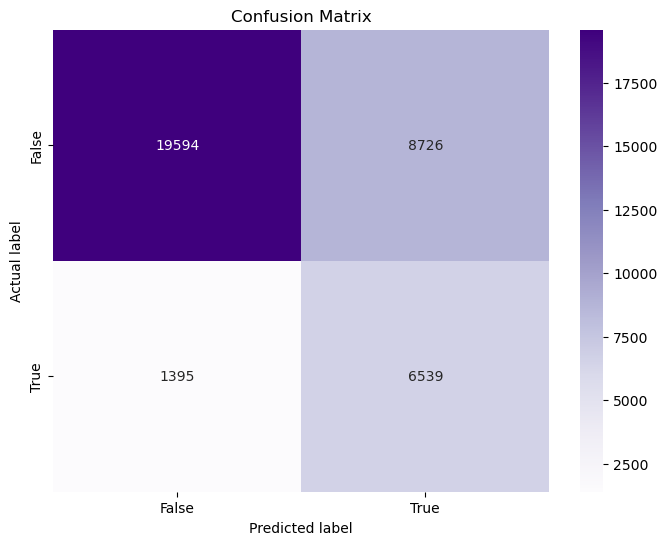

----------------------------------------------------------------------


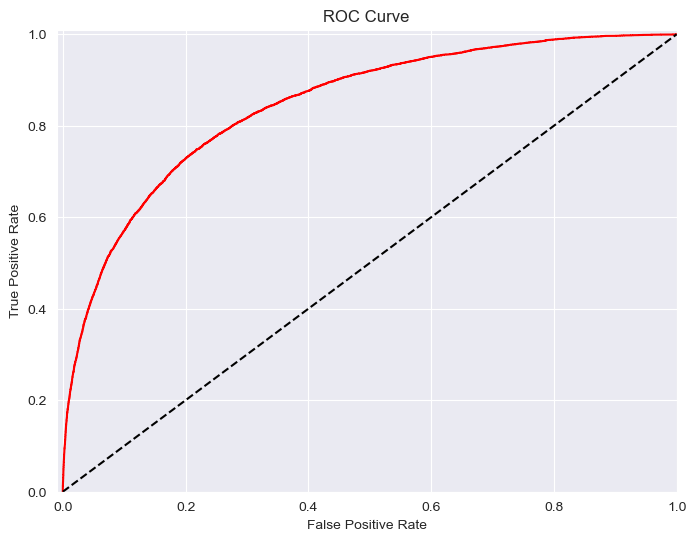

----------------------------------------------------------------------
Precision: 0.4284
Recall: 0.8242
F1 score: 0.5637
ROC-AUC score : 0.8453
----------------------------------------
Train score: 0.7600
Test score: 0.7208
----------------------------------------

Classification Report:
               precision    recall  f1-score   support

           0       0.93      0.69      0.79     28320
           1       0.43      0.82      0.56      7934

    accuracy                           0.72     36254
   macro avg       0.68      0.76      0.68     36254
weighted avg       0.82      0.72      0.74     36254



In [133]:
results(bayes_best_model, y_pred, y_pred_proba, X_train, y_train, X_test, y_test)

### Baseline Model vs Model after tuning

After tuning, the model's performance improves across all metrics.
There is a noticeable overfitting for the baseline model, as the results on the training set are better than those on the test set. After applying tuning, the results improved and converged, reducing overfitting.

## SVM

### Baseline Model

- using SVC class (commented out due to high computional complexity and time) - **O(n_features * n_samples^2) !!!**

For datasets exceeding fifty thousand rows, the algorithm implementation experiences significant slowdown. In lieu of this, LinearSVC was used in this analysis.

In [134]:
# svm_rbf_model = SVC(kernel="rbf")
# svm_rbf_model.fit(X_train, y_train)

- using LinearSVC class

It is a linear classifier that aims to find the optimal hyperplane to separate different classes in the input data. LinearSVC is particularly effective for binary and multiclass classification tasks and is based on the Support Vector Machine (SVM) algorithm.

In [135]:
svm_model = LinearSVC(random_state=0, C=1)
svm_model.fit(X_train, y_train)

LinearSVC(C=1, random_state=0)

This model does not implement the predict_proba method, only predict:

In [136]:
y_pred = svm_model.predict(X_test)

In [137]:
print(f"Precision: {precision_score(y_test, y_pred):.4f}")
print(f"Recall: {recall_score(y_test, y_pred):.4f}")
print(f"F1 score: {f1_score(y_test, y_pred):.4f}")

Precision: 0.5384
Recall: 0.7837
F1 score: 0.6383


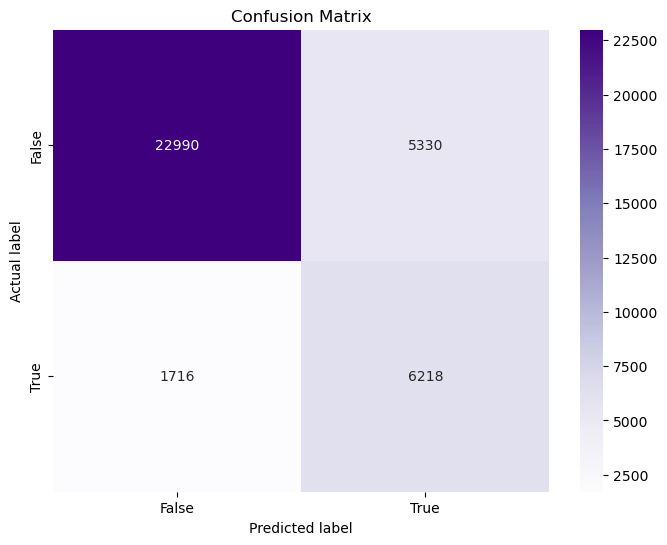

In [138]:
plot_conf_matrix(y_pred, X_test, y_test)

Another potential option is to utilize the OVRClassifier with n_jobs=-1 in order to accelerate the Support Vector Classification (SVC) implementation from sklearn:

In [139]:
# from sklearn.multiclass import OneVsRestClassifier
# clf = OneVsRestClassifier(SVC(kernel="linear", probability=True), n_jobs=-1)
# clf.fit(X_train, y_train)
# y_pred = clf.predict(X_test)
# y_pred_proba = clf.predict_proba(X_test)

### Model Tuning

- using SVC class (commented out due to high computional complexity and time)

In [140]:
# svm_rbf_model = SVC(kernel="rbf")
# svm_rbf_model.fit(X_train, y_train)

In [141]:
# params = {"C": [0.1, 1, 5],
#           "gamma": [0.5, 1, 2]}

# grid_search_svm = GridSearchCV(estimator=svm_rbf_model, param_grid=params,
#                                  refit="roc_auc", scoring=["f1", "roc_auc"], cv=10, n_jobs=-1)

# grid_search_svm.fit(X_train, y_train)

- using LinearSVC class

In [142]:
params = {"penalty": ["l1", "l2"],
          "C": [0.5, 1, 2]}

grid_search_svm = GridSearchCV(estimator=svm_model, param_grid=params,
                               refit="roc_auc", scoring=["f1", "roc_auc"], cv=10, n_jobs=-1)

grid_search_svm.fit(X_train, y_train)

/Users/kkozik/Library/anaconda3/envs/psi_env/lib/python3.10/site-packages/sklearn/svm/_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(
/Users/kkozik/Library/anaconda3/envs/psi_env/lib/python3.10/site-packages/sklearn/svm/_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(
/Users/kkozik/Library/anaconda3/envs/psi_env/lib/python3.10/site-packages/sklearn/svm/_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(
/Users/kkozik/Library/anaconda3/envs/psi_env/lib/python3.10/site-packages/sklearn/svm/_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value

/Users/kkozik/Library/anaconda3/envs/psi_env/lib/python3.10/site-packages/sklearn/svm/_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(
/Users/kkozik/Library/anaconda3/envs/psi_env/lib/python3.10/site-packages/sklearn/svm/_base.py:1242: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/Users/kkozik/Library/anaconda3/envs/psi_env/lib/python3.10/site-packages/sklearn/svm/_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(
/Users/kkozik/Library/anaconda3/envs/psi_env/lib/python3.10/site-packages/sklearn/svm/_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(

/Users/kkozik/Library/anaconda3/envs/psi_env/lib/python3.10/site-packages/sklearn/svm/_base.py:1242: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/Users/kkozik/Library/anaconda3/envs/psi_env/lib/python3.10/site-packages/sklearn/svm/_base.py:1242: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/Users/kkozik/Library/anaconda3/envs/psi_env/lib/python3.10/site-packages/sklearn/svm/_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(
/Users/kkozik/Library/anaconda3/envs/psi_env/lib/python3.10/site-packages/sklearn/svm/_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(
/Users/kkozik/Library/anaconda3/envs/psi_env/lib/python3.10/si

GridSearchCV(cv=10, estimator=LinearSVC(C=1, random_state=0), n_jobs=-1,
             param_grid={'C': [0.5, 1, 2], 'penalty': ['l1', 'l2']},
             refit='roc_auc', scoring=['f1', 'roc_auc'])

In [143]:
grid_search_svm.best_params_, grid_search_svm.best_score_

({'C': 0.5, 'penalty': 'l2'}, 0.20131696851645203)

In [144]:
svm_model = grid_search_svm.best_estimator_

In [145]:
y_pred = svm_model.predict(X_test)

In [146]:
print(f"Precision: {precision_score(y_test, y_pred):.4f}")
print(f"Recall: {recall_score(y_test, y_pred):.4f}")
print(f"F1 score: {f1_score(y_test, y_pred):.4f}")

Precision: 0.5386
Recall: 0.7835
F1 score: 0.6383


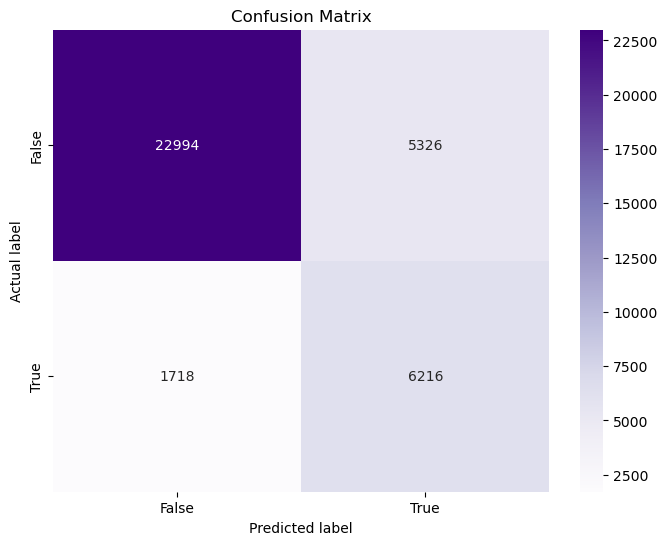

In [147]:
plot_conf_matrix(y_pred, X_test, y_test)

# Logistic Regression vs KNN vs Naive Bayes vs (Linear) SVC - Conclusions

Let's compare the results of four models across various metrics:

- Logistic Regression:

Precision: 0.5362

Recall: 0.7847

F1 score: 0.6371

ROC-AUC score: 0.8815

Train score: 0.8067

Test score: 0.8043

- K-Nearest Neighbors (KNN):

Precision: 0.4748

Recall: 0.8190

F1 score: 0.6011

ROC-AUC score: 0.8468

Accuracy: 0.76

- Naive Bayes:

Precision: 0.4284

Recall: 0.8242

F1 score: 0.5637

ROC-AUC score: 0.8453

Train score: 0.7600

Test score: 0.7208

- Linear Support Vector Classifier (LinearSVC):

Precision: 0.5386

Recall: 0.7835

F1 score: 0.6383


**Observations:**

- Logistic Regression and LinearSVC have comparable precision, while KNN and Naive Bayes show lower values.
- Naive Bayes has the highest recall, followed by KNN, Logistic Regression and LinearSVC.
- Logistic Regression and LinearSVC demonstrate similar F1 scores, outperforming KNN and Naive Bayes.
- Logistic Regression has the highest ROC-AUC score, indicating strong overall performance. KNN and Naive Bayes follow closely, while LinearSVC doesn't have a ROC-AUC score provided.
- Logistic Regression and KNN show competitive accuracy, while Naive Bayes has a slightly lower accuracy. LinearSVC doesn't have an accuracy value provided.

**Conclusions:**

Logistic Regression emerges as the overall top performer, showcasing a commendable equilibrium between precision, recall, and ROC-AUC score. Naive Bayes stands out particularly in recall, yet it trails behind in precision and F1 score. Meanwhile, LinearSVC demonstrates competitive precision and recall, but a comprehensive evaluation is limited by the absence of additional performance metrics. In comparison, KNN delivers reasonably good results, but it falls short of Logistic Regression across various metrics.